# Imports

In [1]:
import deeplake
import matplotlib.pyplot as plt
from datetime import datetime
import os
import random
import numpy as np
from datetime import datetime
from sklearn import metrics
import matplotlib.lines as lines
import matplotlib.text as text
import pandas as pd

/usr/local/lib/python3.10/site-packages/deeplake/util/check_latest_version.py:32: UserWarning: A newer version of deeplake (3.2.0) is available. It's recommended that you update to the latest version using `pip install -U deeplake`.
  warnings.warn(


In [3]:
# import wandb
# from wandb.keras import WandbCallback

# Data exploration

In [23]:
ds = deeplake.load('hub://earthshot-labs/Depth_Map_DBH_dataset_decimeters')
ds.summary()


hub://earthshot-labs/Depth_Map_DBH_dataset_decimeters loaded successfully.
This dataset can be visualized in Jupyter Notebook by ds.visualize() or at https://app.activeloop.ai/earthshot-labs/Depth_Map_DBH_dataset_decimeters
Dataset(path='hub://earthshot-labs/Depth_Map_DBH_dataset_decimeters', tensors=['DBH', 'depth_maps', 'images'])

   tensor     htype          shape          dtype  compression
  -------    -------        -------        -------  ------- 
    DBH      generic       (1008, 1)       float32   None   
 depth_maps  generic   (1008, 192, 192)     uint8    None   
   images     image   (1008, 192, 192, 3)   uint8     png   


In [24]:
import numpy as np
max_list = []
for i, sample in enumerate(ds):
    max_list.append(np.max(sample.depth_maps.numpy()))
print(np.max(np.array(max_list)))

251


In [25]:
DBH_list = []
for i, sample in enumerate(ds):
    DBH_list.append(sample.DBH.numpy()[0])
print(len(DBH_list))

1008


In [26]:
DBH_list[0:10]

[3.023944,
 2.0690143,
 2.2281692,
 14.960565,
 15.915494,
 14.642255,
 44.881695,
 44.881695,
 44.881695,
 47.109863]

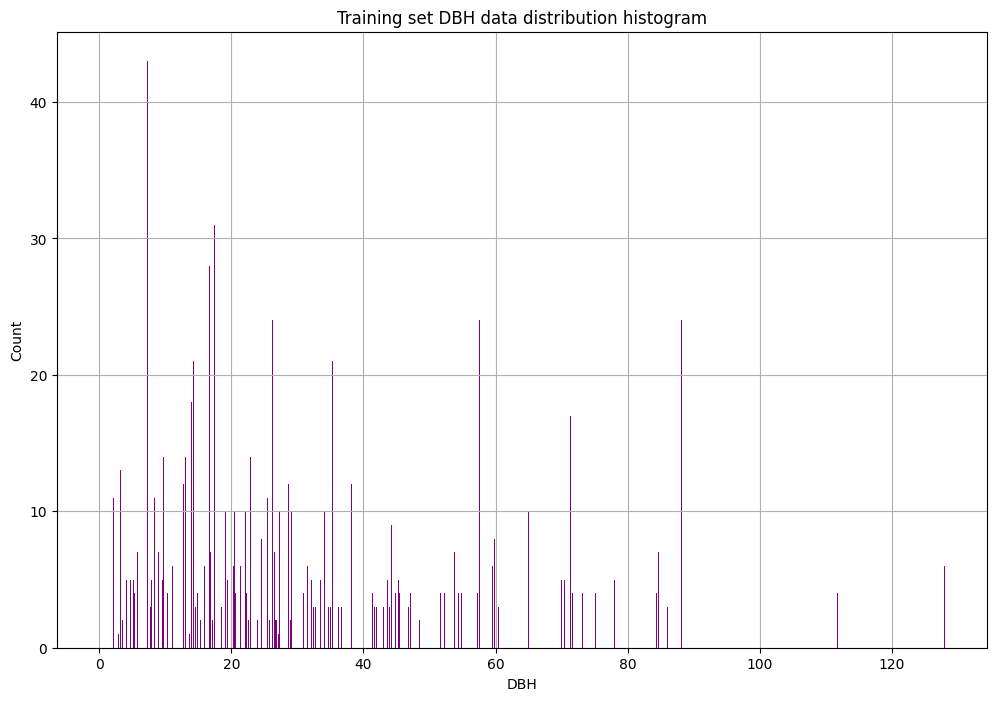

In [27]:
DBH_df = pd.DataFrame({'DBH': np.array(DBH_list)})
DBH_df.hist(figsize=[12, 8], bins=len(DBH_list), color='purple')
plt.title('Training set DBH data distribution histogram')
plt.xlabel('DBH')
plt.ylabel('Count')
plt.savefig(f"train_set_data_repartition_hist.png", dpi=500)

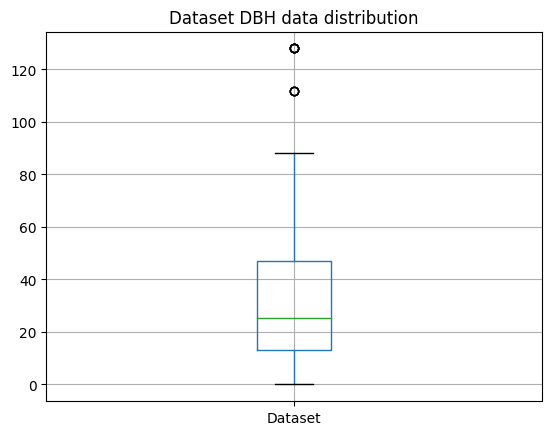

In [41]:
DBH_df_dataset = pd.DataFrame({'Dataset': np.array(DBH_list)})
boxplot = DBH_df_dataset.boxplot(column=['Dataset'])  
plt.title('Dataset DBH data distribution')
# plt.ylabel('DBH')
# plt.xlabel('hello')
plt.savefig(f"train_set_data_repartition_boxplot.png", dpi=1000)

# Inference / tests / Metrics

In [29]:
ds_test = deeplake.load('hub://earthshot-labs/Depth_Map_DBH_test_dataset_decimeters')
ds_test.summary()


hub://earthshot-labs/Depth_Map_DBH_test_dataset_decimeters loaded successfully.
This dataset can be visualized in Jupyter Notebook by ds.visualize() or at https://app.activeloop.ai/earthshot-labs/Depth_Map_DBH_test_dataset_decimeters
Dataset(path='hub://earthshot-labs/Depth_Map_DBH_test_dataset_decimeters', tensors=['DBH', 'depth_maps', 'images'])

   tensor     htype         shape          dtype  compression
  -------    -------       -------        -------  ------- 
    DBH      generic       (164, 1)       float32   None   
 depth_maps  generic   (164, 192, 192)     uint8    None   
   images     image   (164, 192, 192, 3)   uint8     png   


In [30]:
import numpy as np
max_list = []
for i, sample in enumerate(ds_test):
    max_list.append(np.max(sample.depth_maps.numpy()))
print(np.max(np.array(max_list)))

244


DBH: 0.0 cm


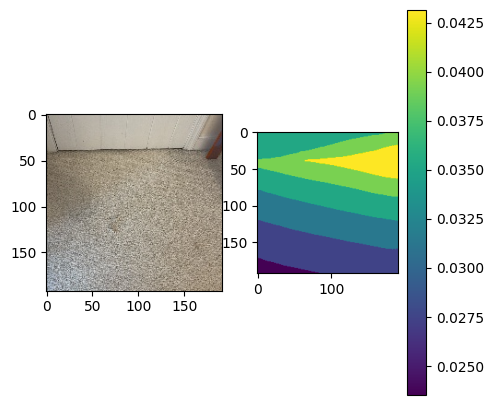

DBH: 9.55 cm


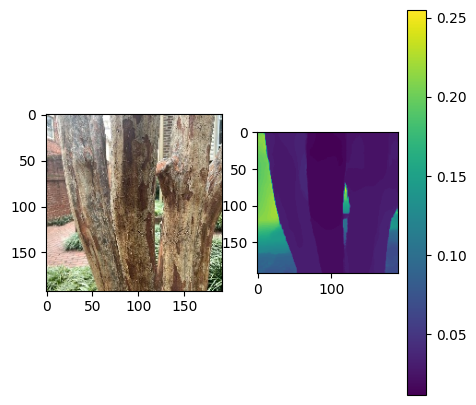

DBH: 9.55 cm


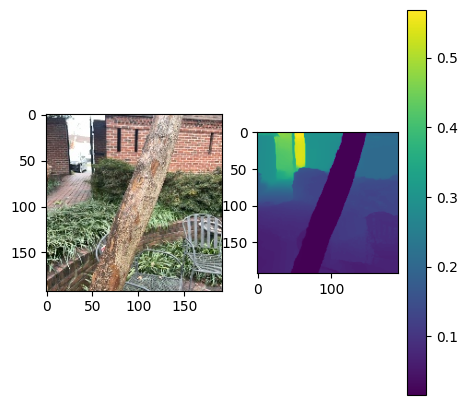

DBH: 9.55 cm


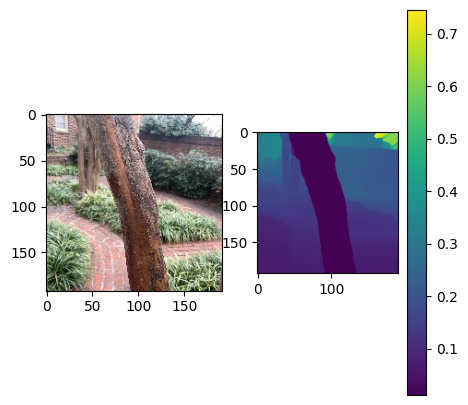

DBH: 12.41 cm


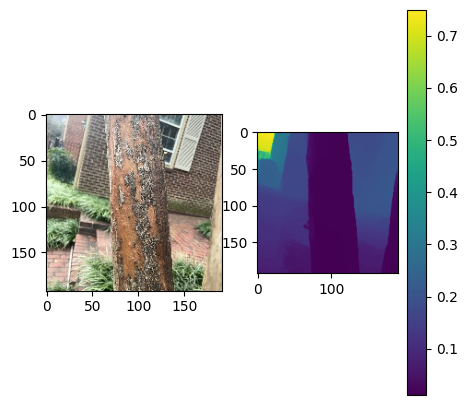

DBH: 12.41 cm


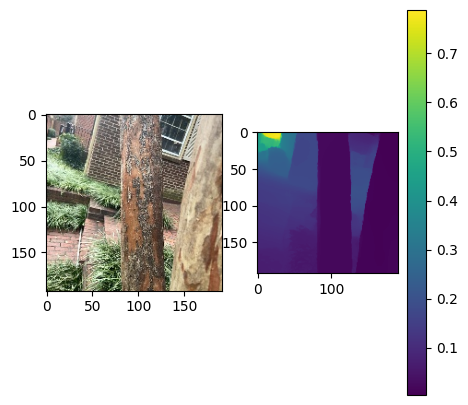

DBH: 12.41 cm


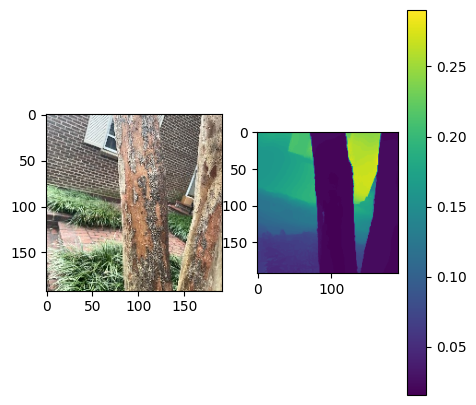

DBH: 14.64 cm


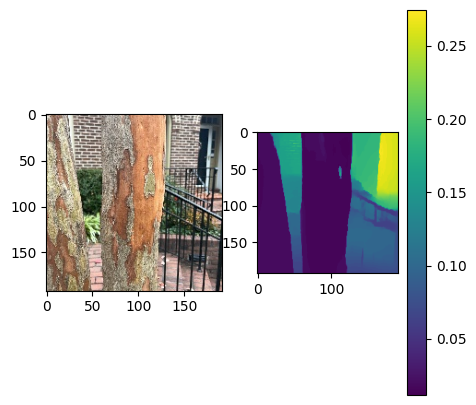

DBH: 14.64 cm


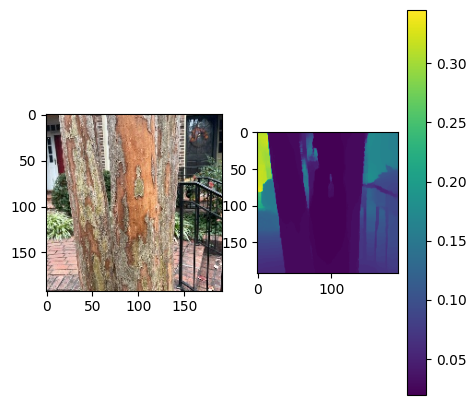

DBH: 14.64 cm


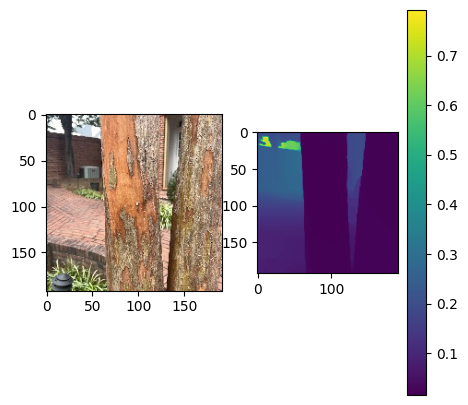

DBH: 7.8 cm


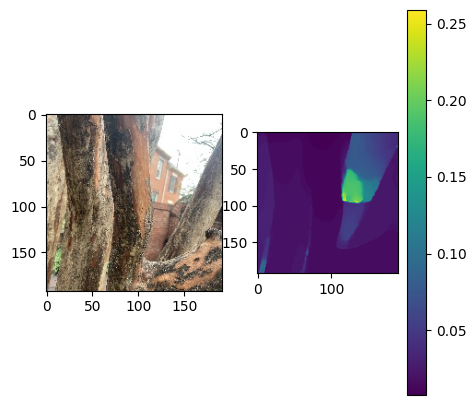

DBH: 7.8 cm


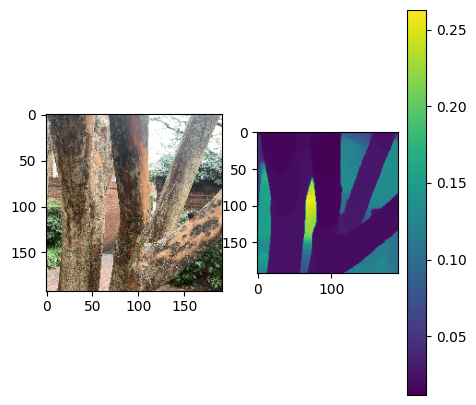

DBH: 7.8 cm


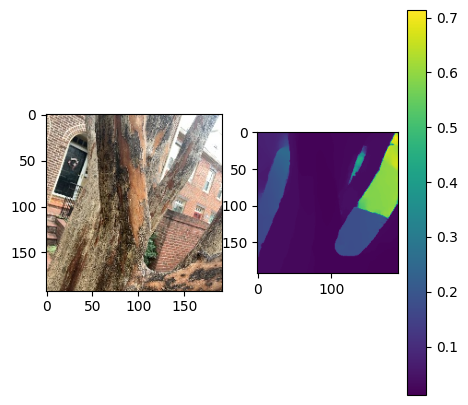

DBH: 17.51 cm


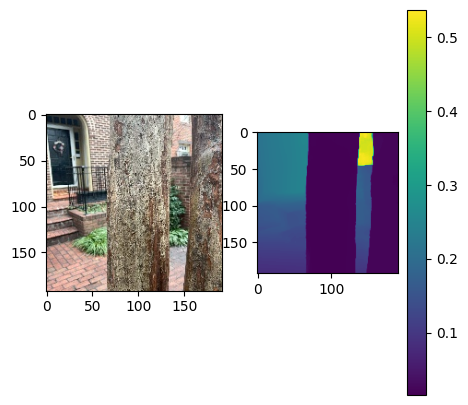

DBH: 17.51 cm


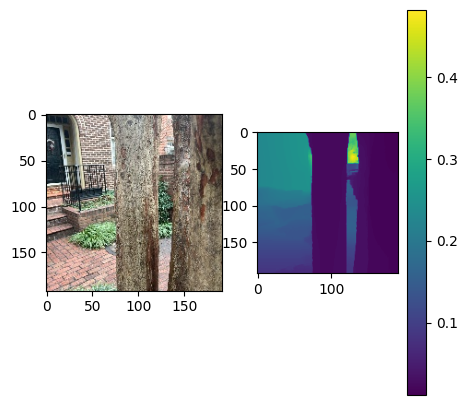

DBH: 17.51 cm


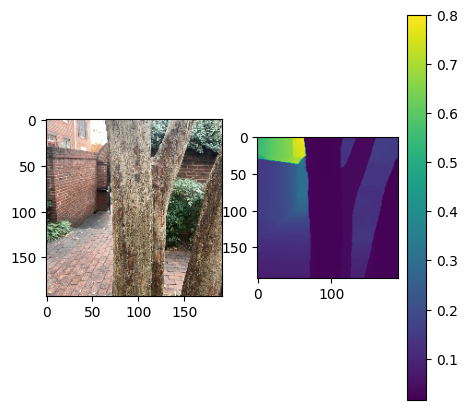

DBH: 17.51 cm


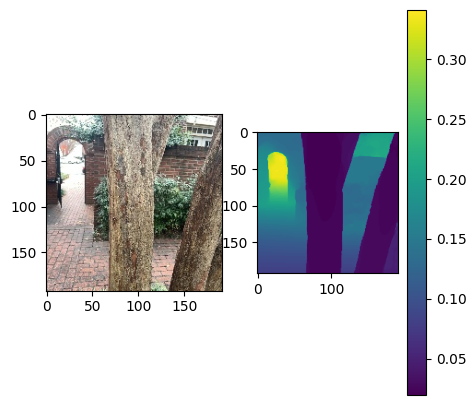

DBH: 9.87 cm


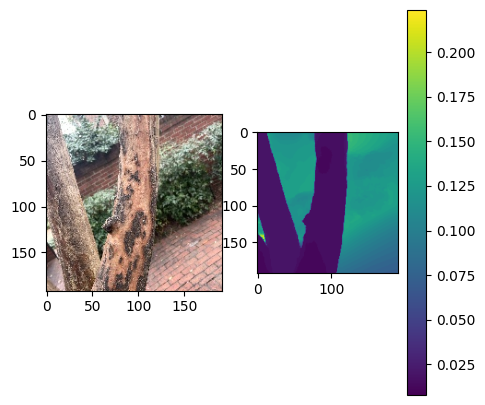

DBH: 9.87 cm


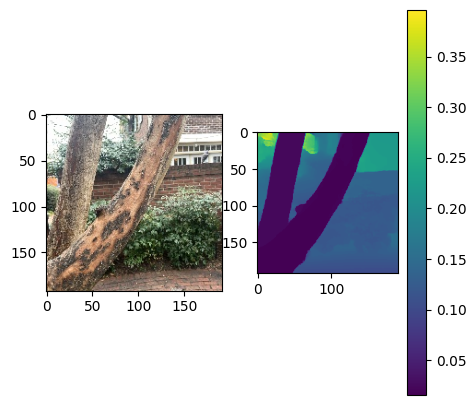

DBH: 9.87 cm


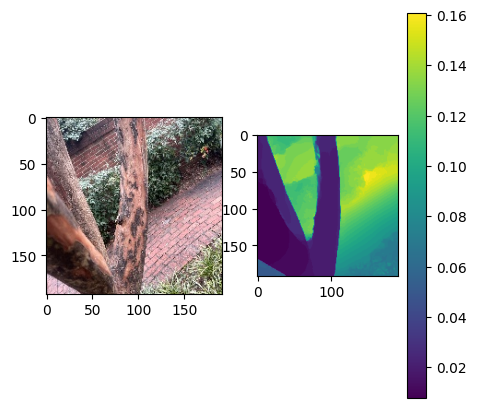

DBH: 9.87 cm


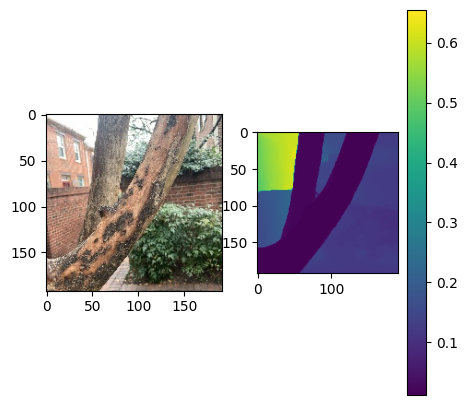

DBH: 29.28 cm


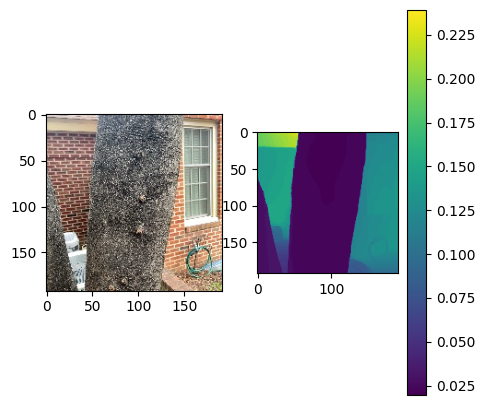

DBH: 29.28 cm


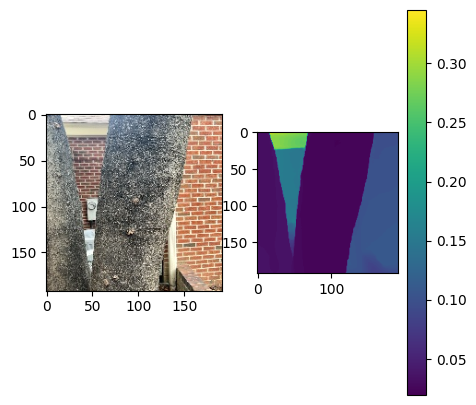

DBH: 29.28 cm


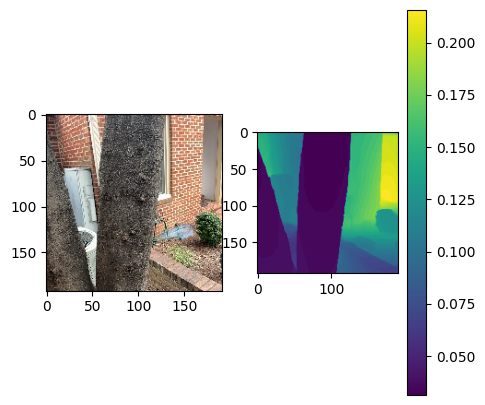

DBH: 29.28 cm


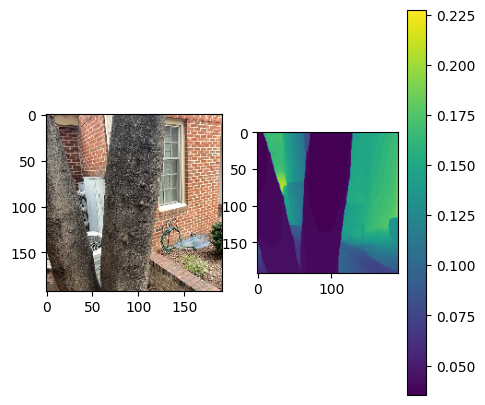

DBH: 29.28 cm


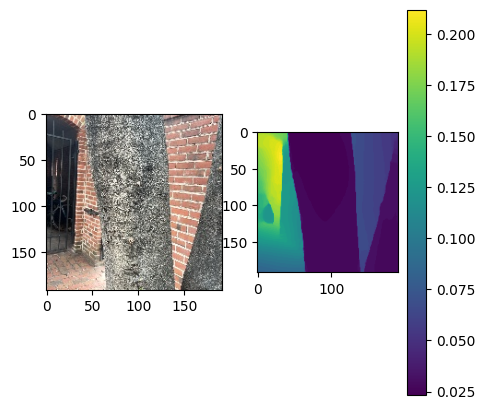

DBH: 24.83 cm


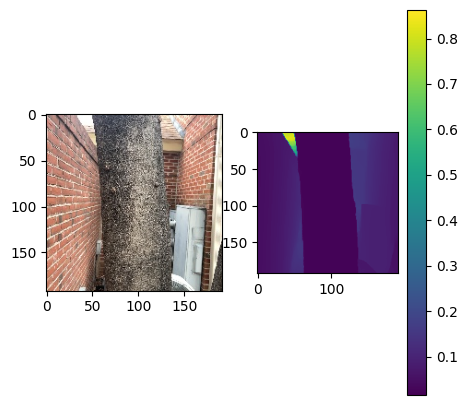

DBH: 24.83 cm


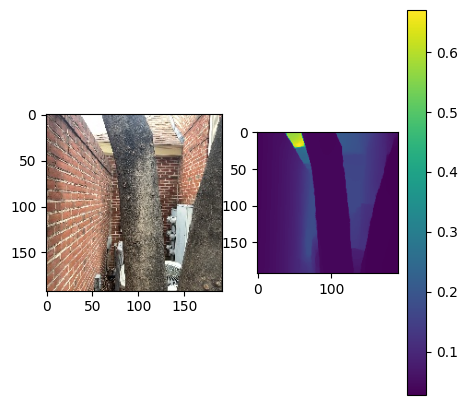

DBH: 24.83 cm


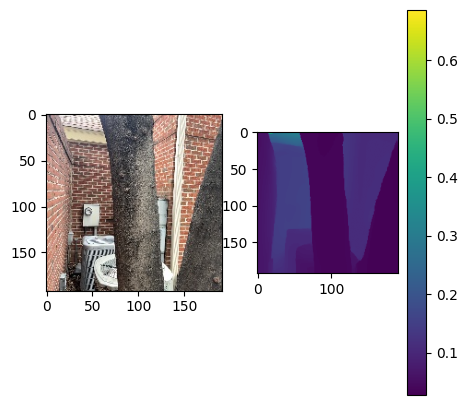

DBH: 24.83 cm


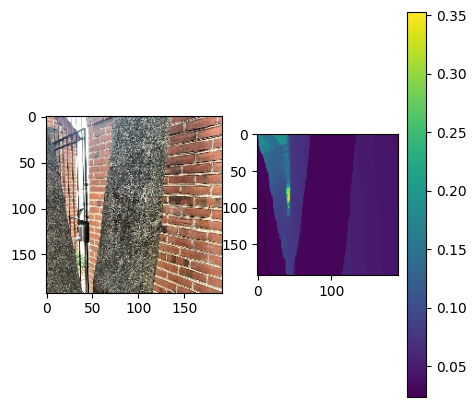

DBH: 9.55 cm


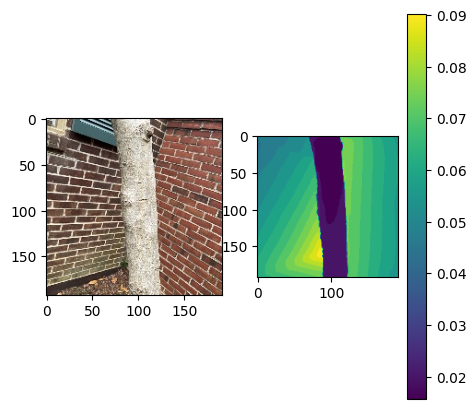

DBH: 9.55 cm


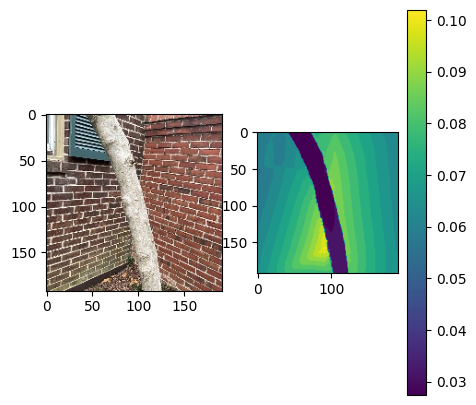

DBH: 9.55 cm


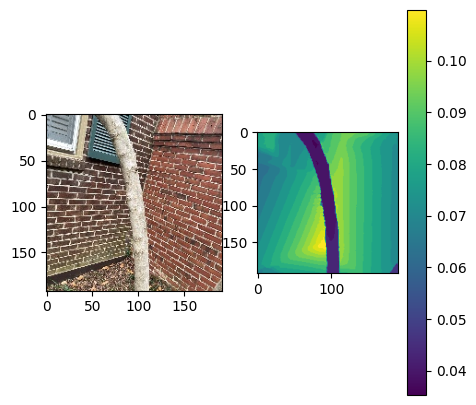

DBH: 16.87 cm


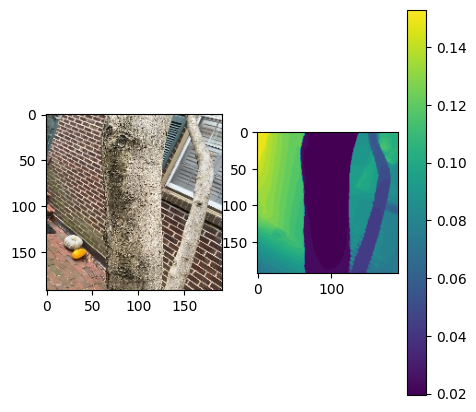

DBH: 16.87 cm


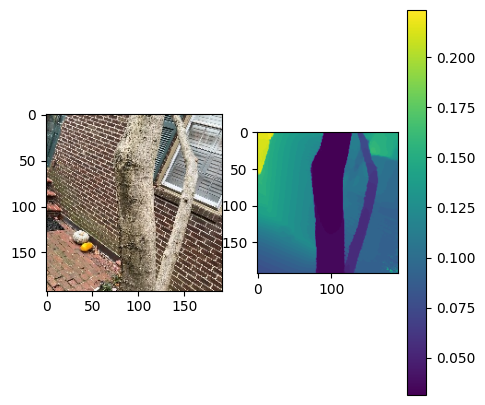

DBH: 16.87 cm


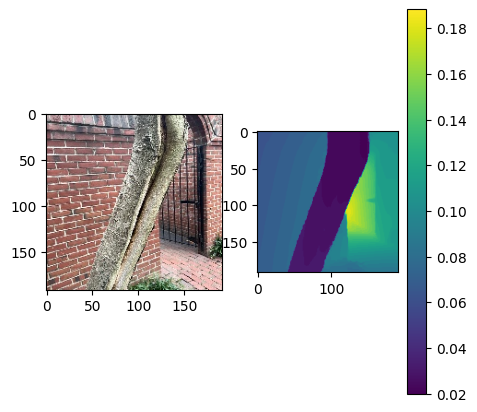

DBH: 3.82 cm


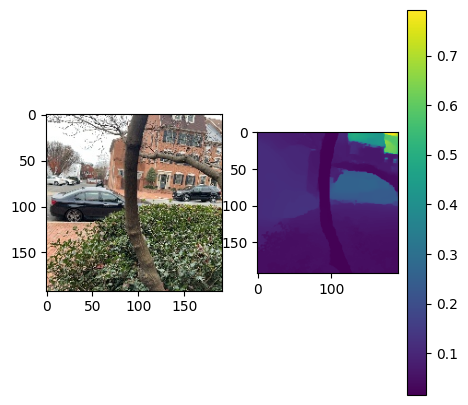

DBH: 3.82 cm


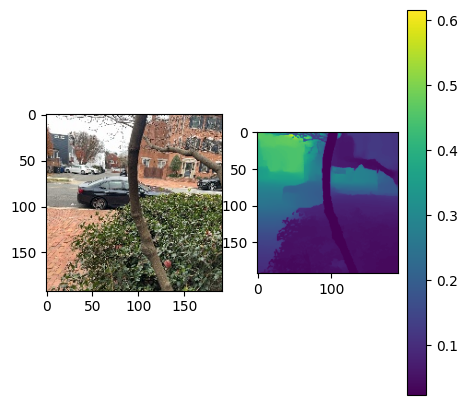

DBH: 3.82 cm


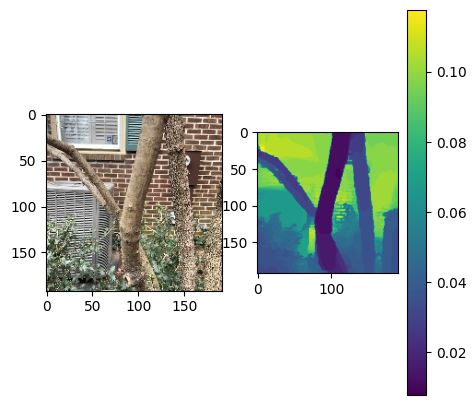

DBH: 3.82 cm


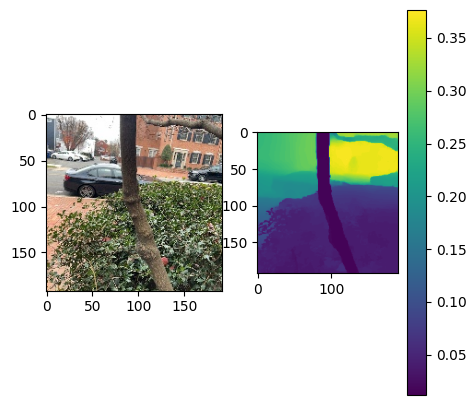

DBH: 3.82 cm


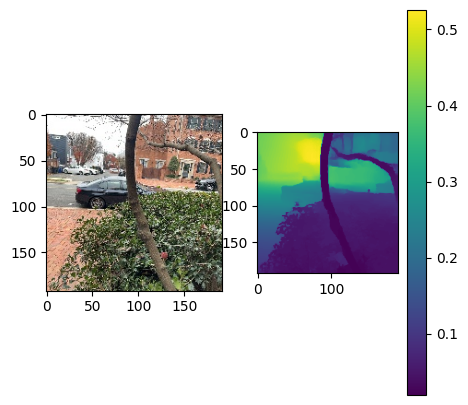

DBH: 7.0 cm


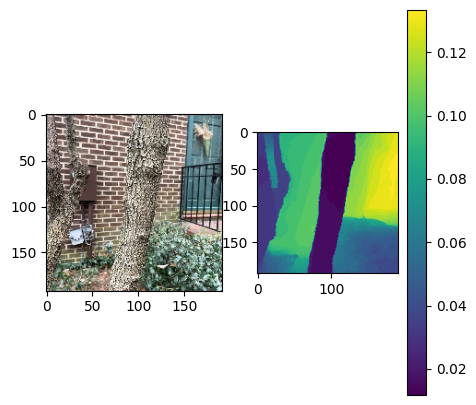

DBH: 7.0 cm


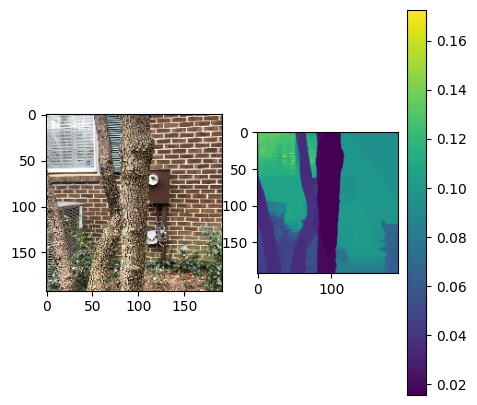

DBH: 7.0 cm


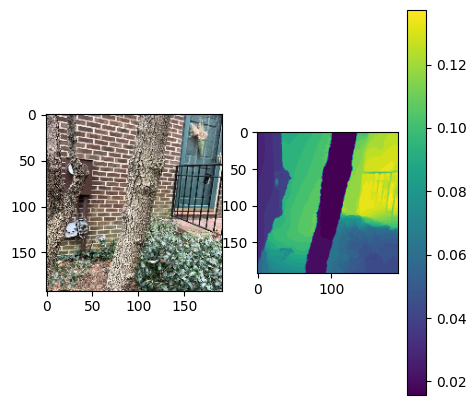

DBH: 7.0 cm


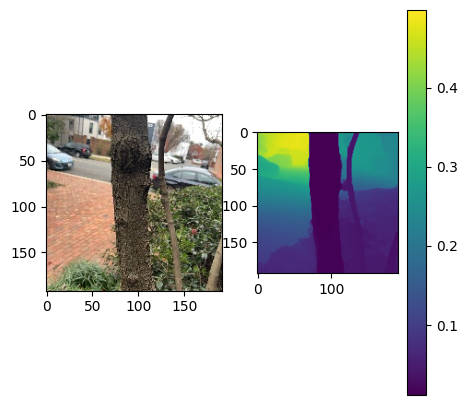

DBH: 0.0 cm


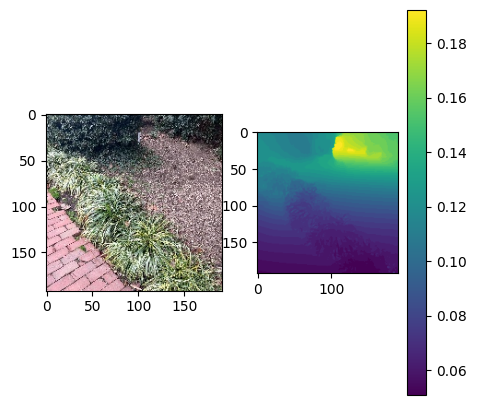

DBH: 0.0 cm


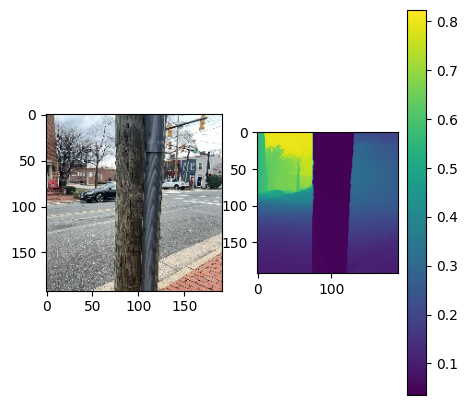

DBH: 0.0 cm


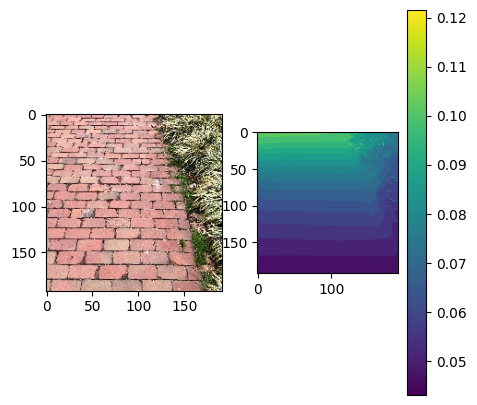

DBH: 0.0 cm


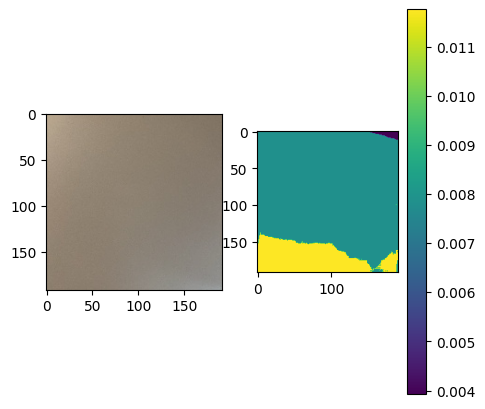

DBH: 0.0 cm


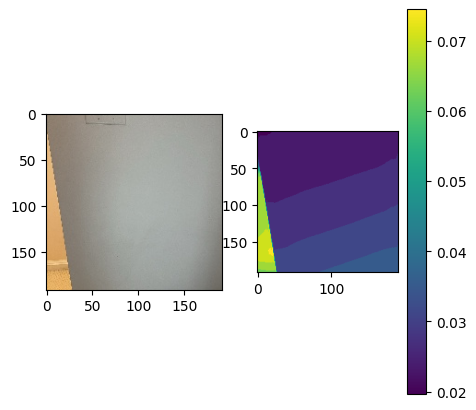

DBH: 0.0 cm


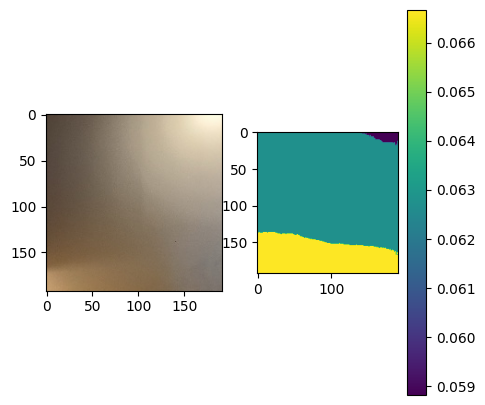

DBH: 0.0 cm


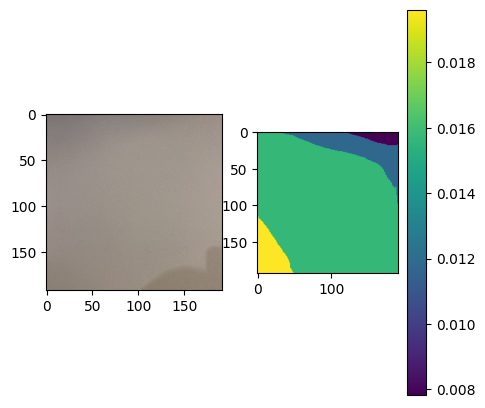

DBH: 79.58 cm


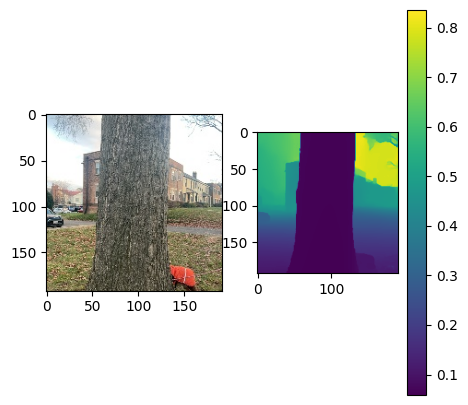

DBH: 79.58 cm


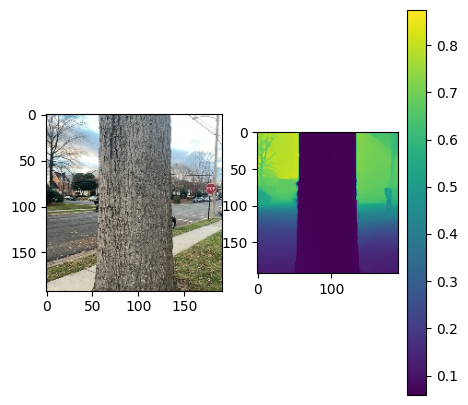

DBH: 79.58 cm


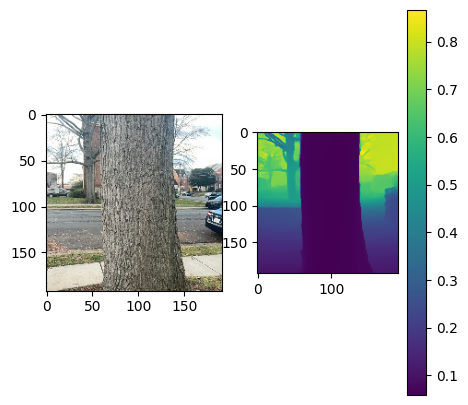

DBH: 79.58 cm


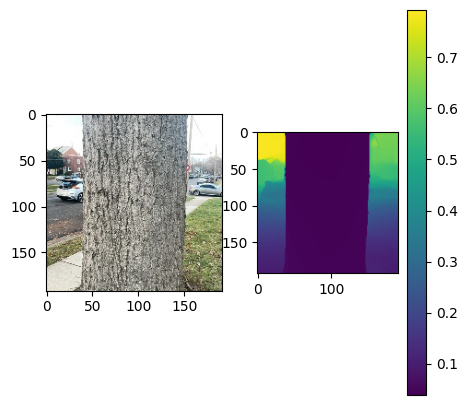

DBH: 92.31 cm


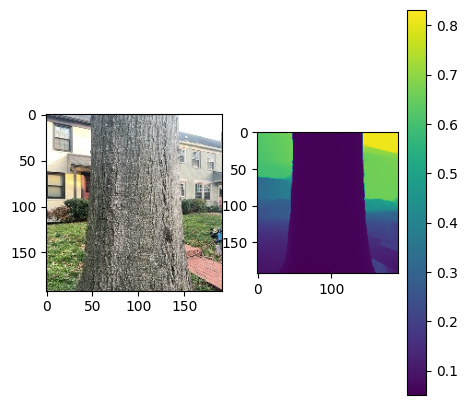

DBH: 92.31 cm


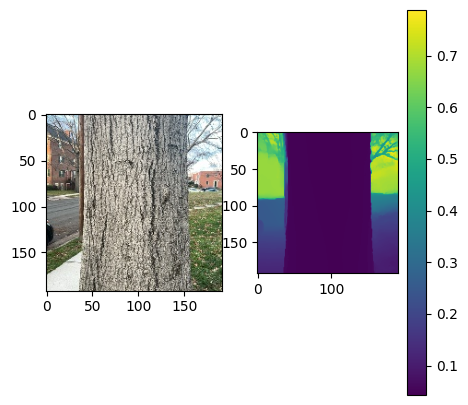

DBH: 92.31 cm


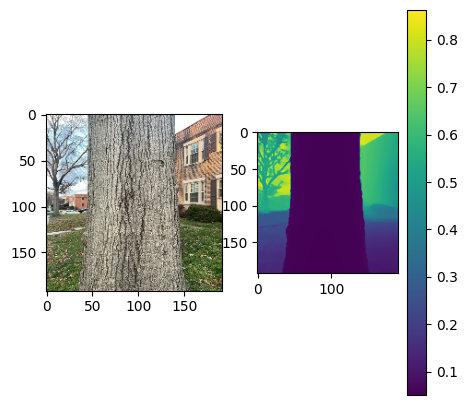

DBH: 72.89 cm


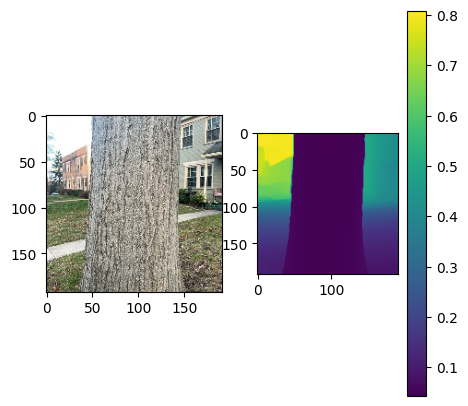

DBH: 72.89 cm


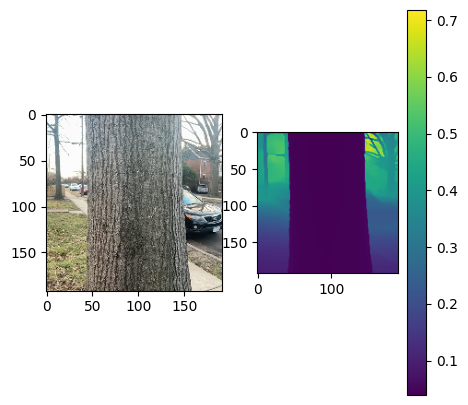

DBH: 42.97 cm


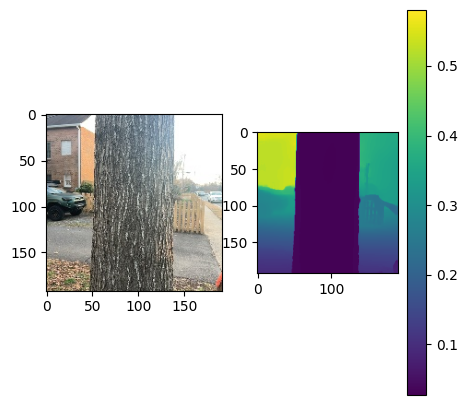

DBH: 42.97 cm


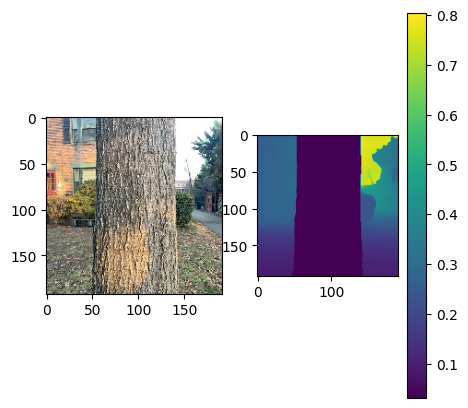

DBH: 42.97 cm


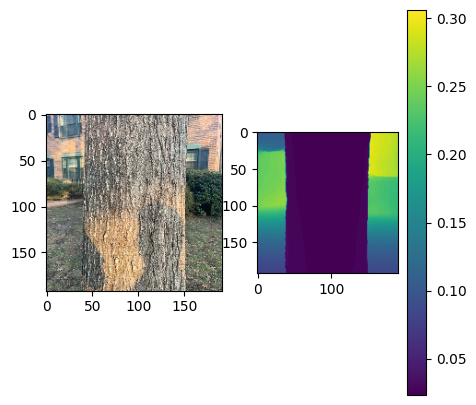

DBH: 42.97 cm


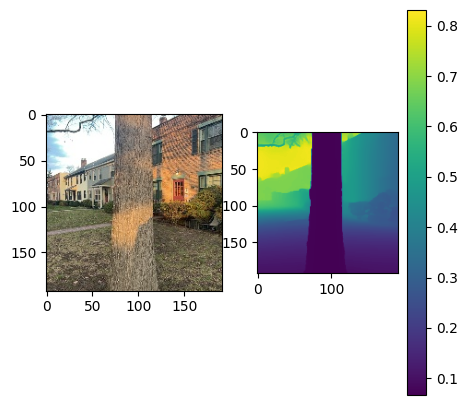

DBH: 11.78 cm


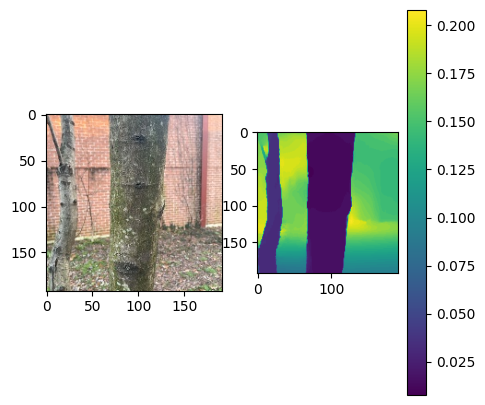

DBH: 11.78 cm


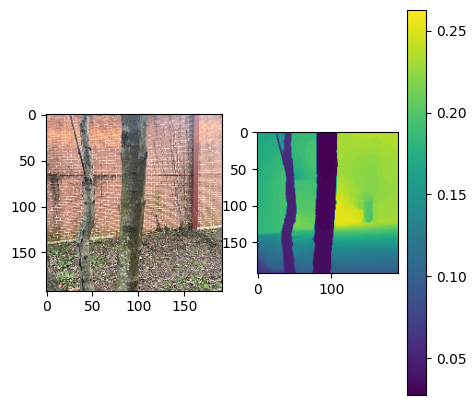

DBH: 8.28 cm


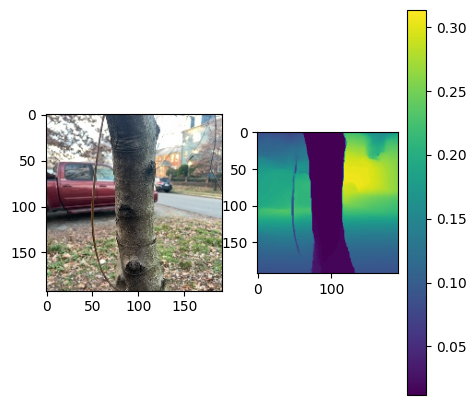

DBH: 8.28 cm


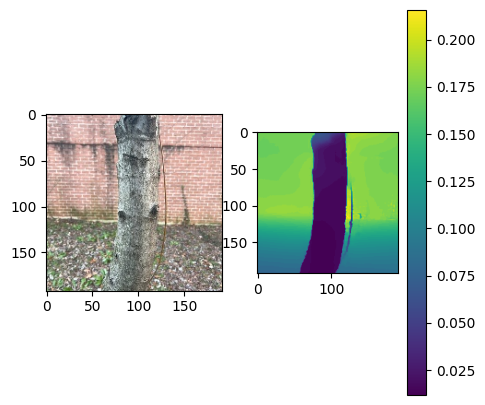

DBH: 8.28 cm


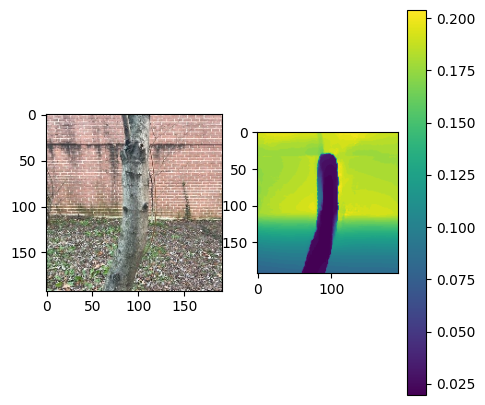

DBH: 10.82 cm


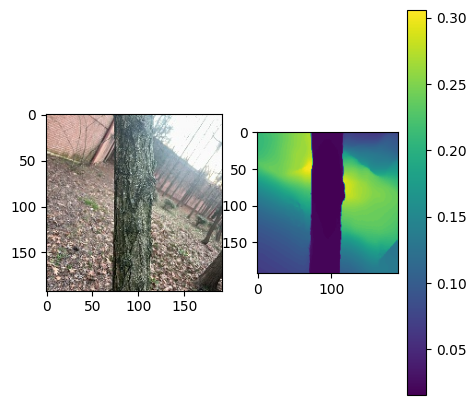

DBH: 10.82 cm


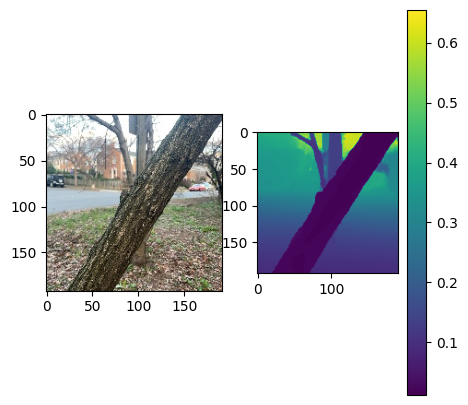

DBH: 17.19 cm


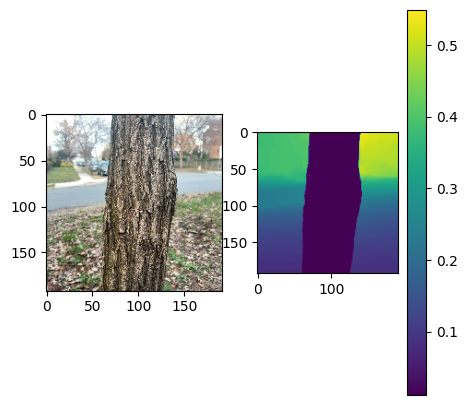

DBH: 17.19 cm


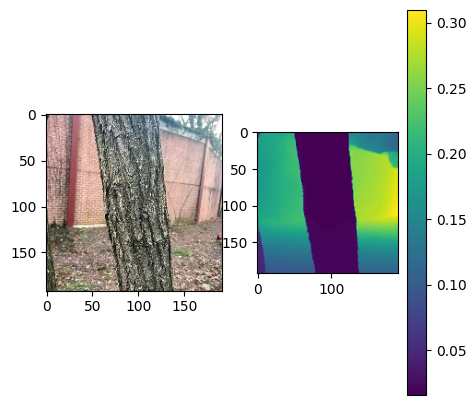

DBH: 17.19 cm


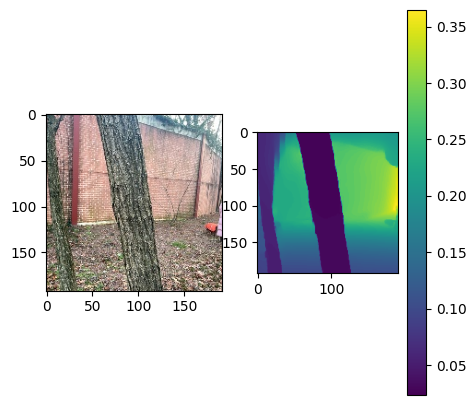

DBH: 10.5 cm


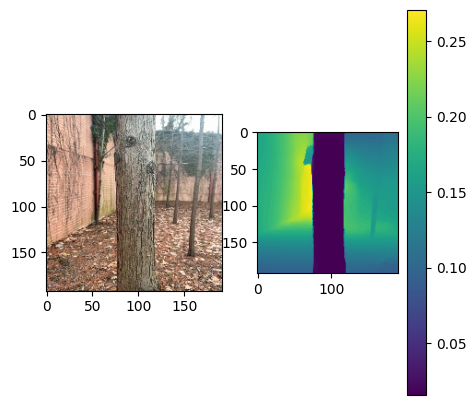

DBH: 10.5 cm


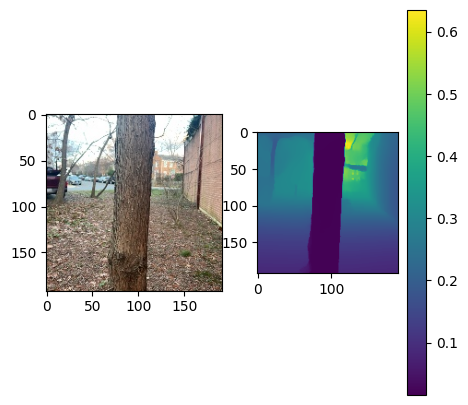

DBH: 14.01 cm


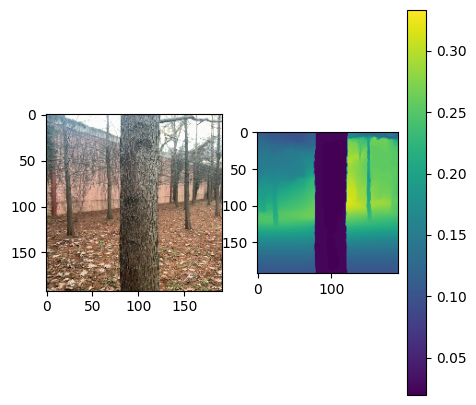

DBH: 10.5 cm


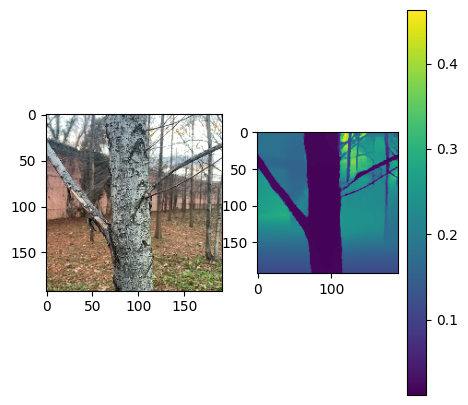

DBH: 15.28 cm


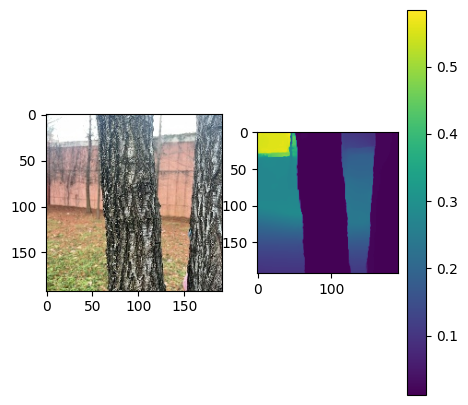

DBH: 7.64 cm


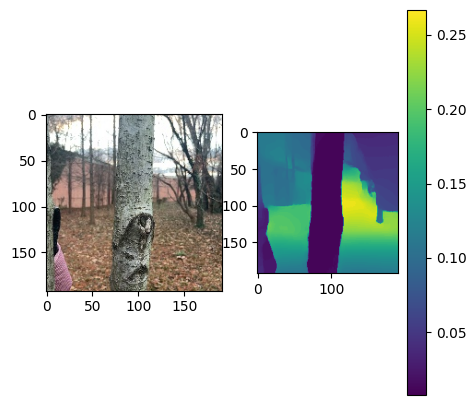

DBH: 7.64 cm


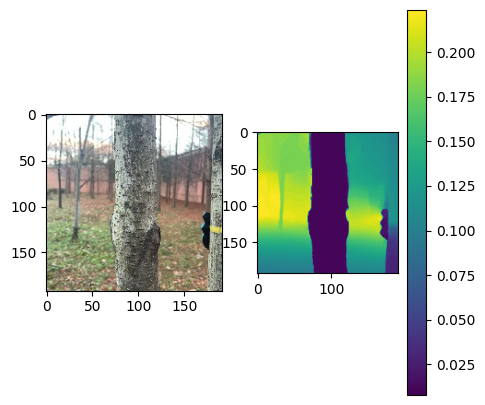

DBH: 10.19 cm


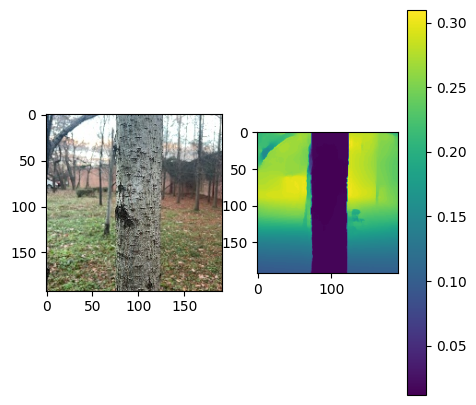

DBH: 10.19 cm


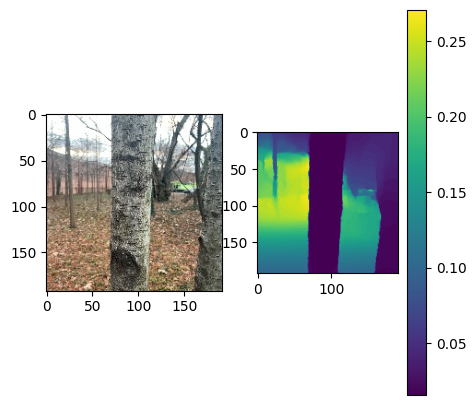

DBH: 17.83 cm


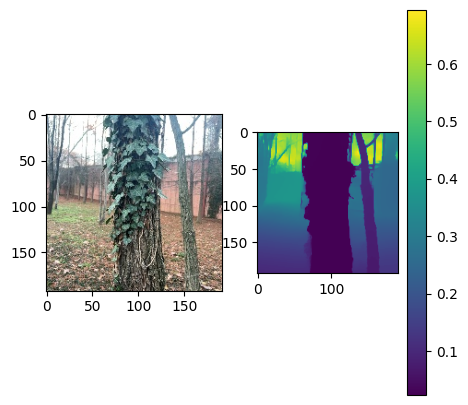

DBH: 109.18 cm


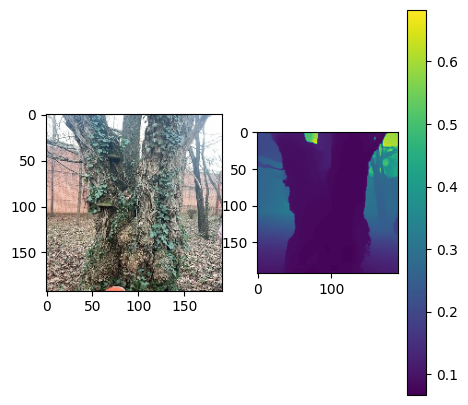

DBH: 109.18 cm


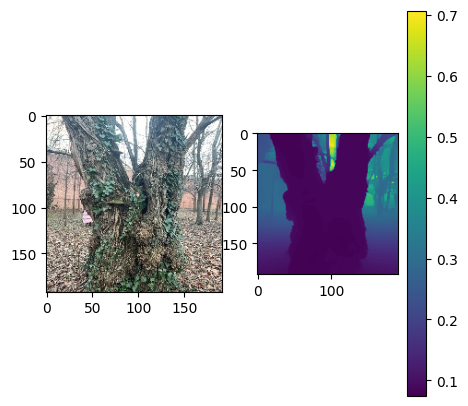

DBH: 3.66 cm


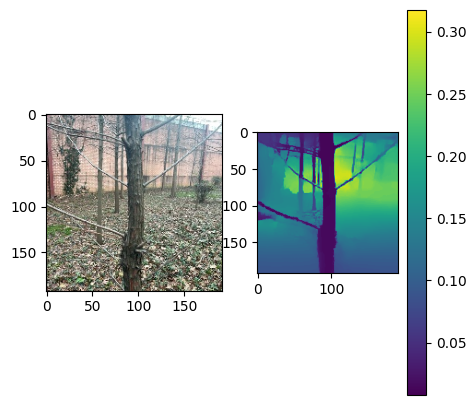

DBH: 3.66 cm


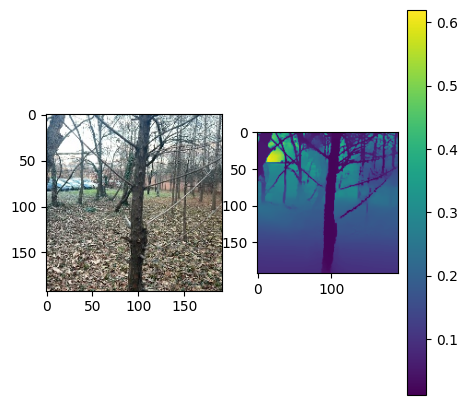

DBH: 3.66 cm


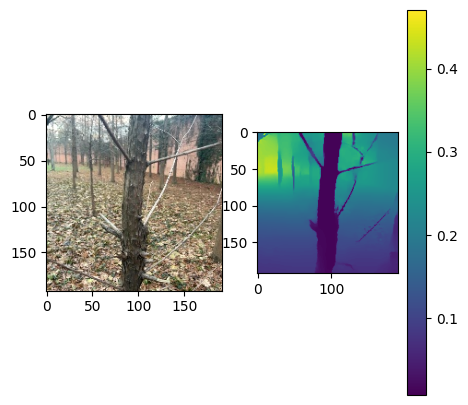

DBH: 31.83 cm


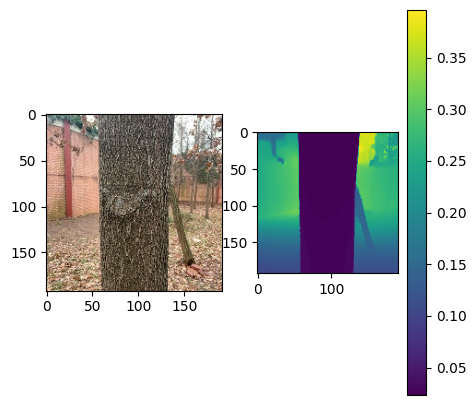

DBH: 24.19 cm


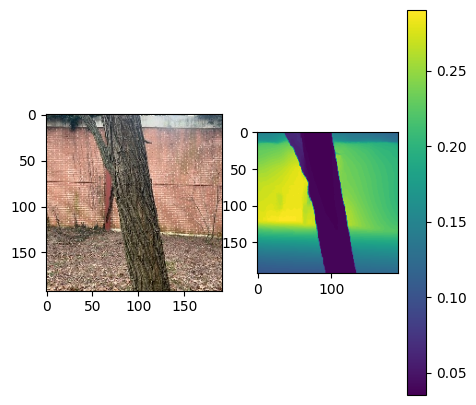

DBH: 16.55 cm


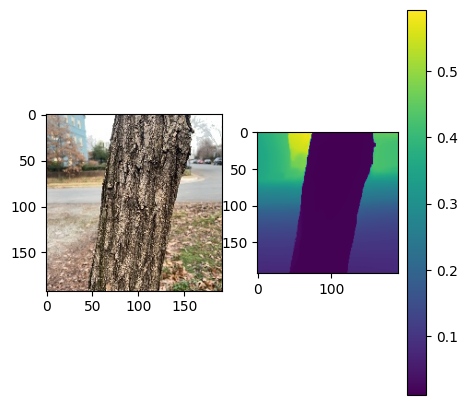

DBH: 10.5 cm


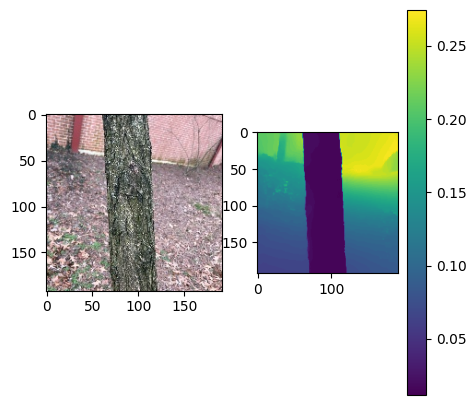

DBH: 14.01 cm


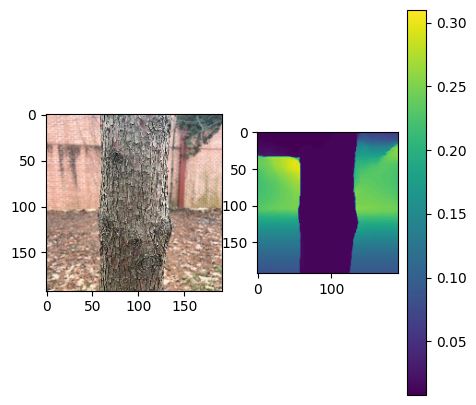

DBH: 14.01 cm


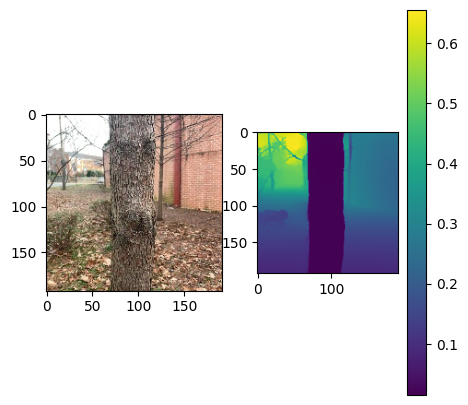

DBH: 14.32 cm


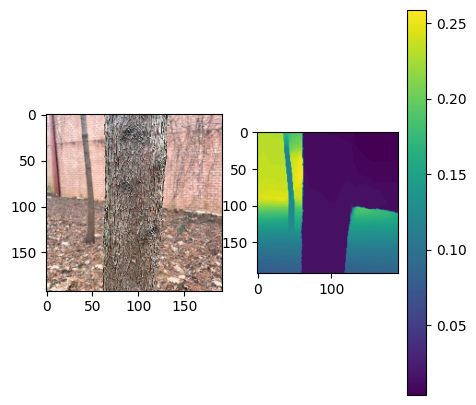

DBH: 14.32 cm


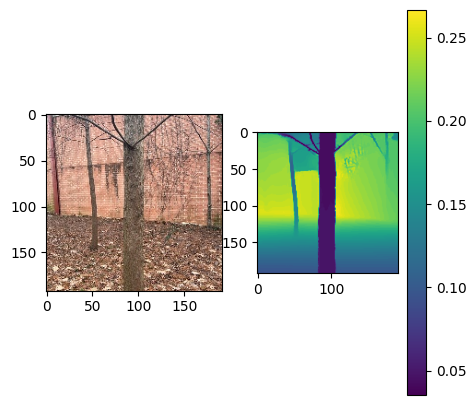

DBH: 18.78 cm


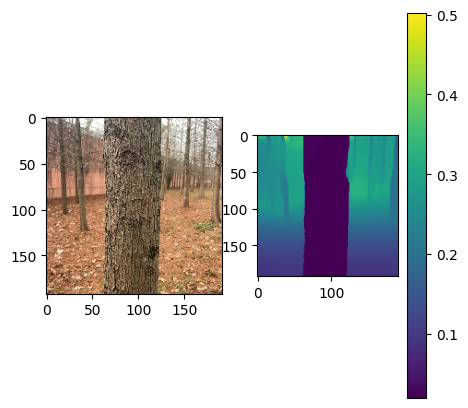

DBH: 18.78 cm


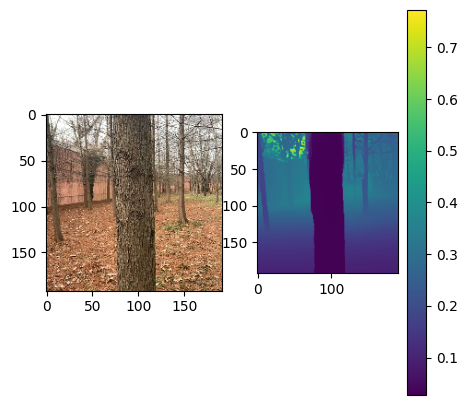

DBH: 14.96 cm


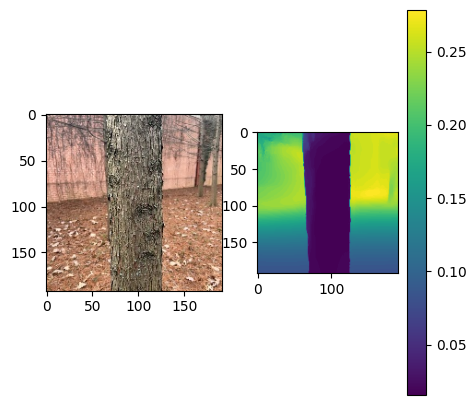

DBH: 14.96 cm


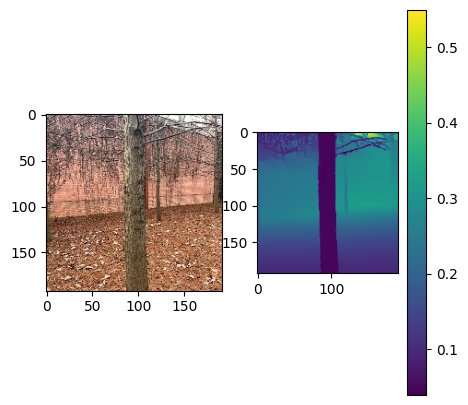

DBH: 11.46 cm


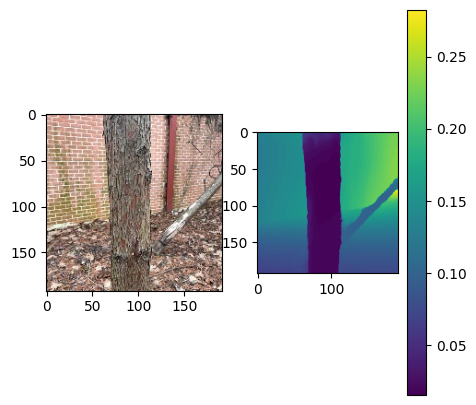

DBH: 11.46 cm


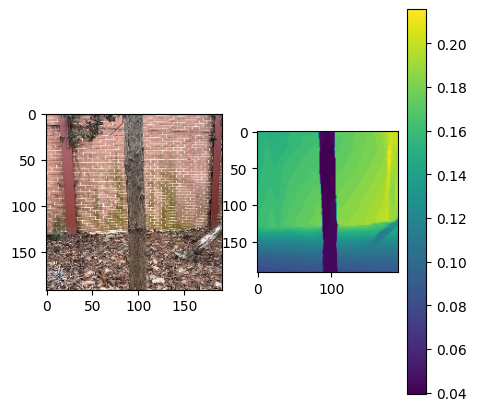

DBH: 10.5 cm


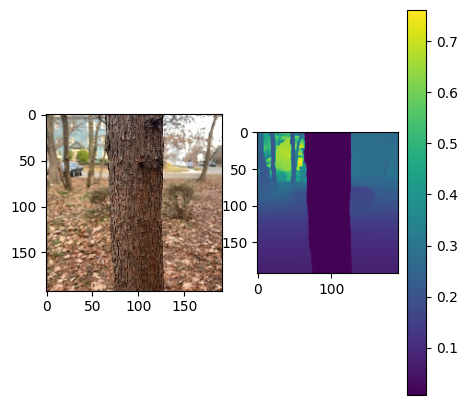

DBH: 21.01 cm


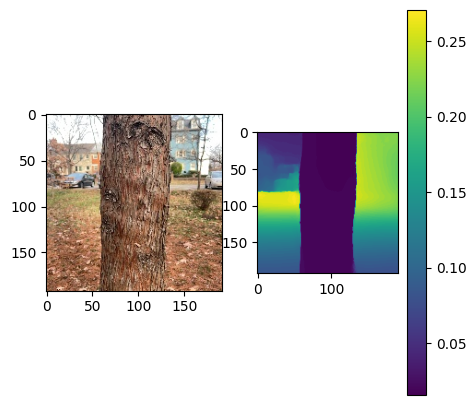

DBH: 21.01 cm


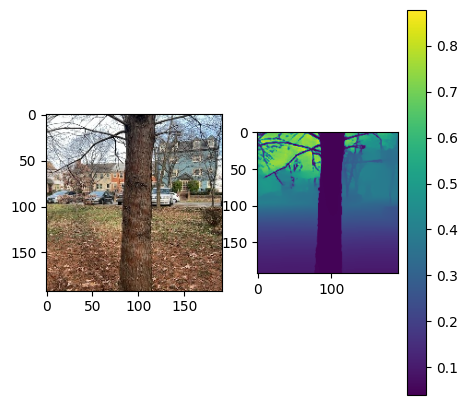

DBH: 25.15 cm


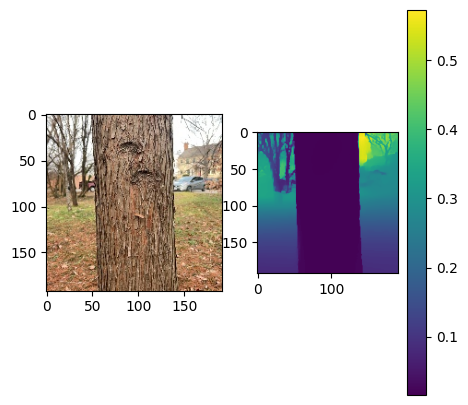

DBH: 25.15 cm


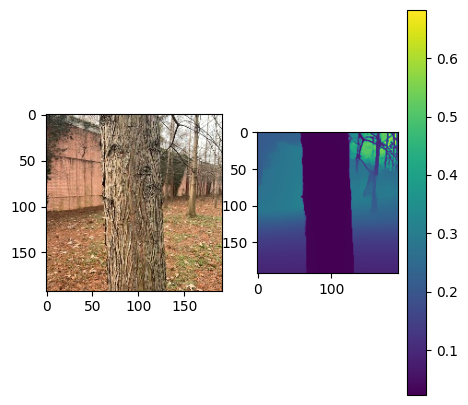

DBH: 25.15 cm


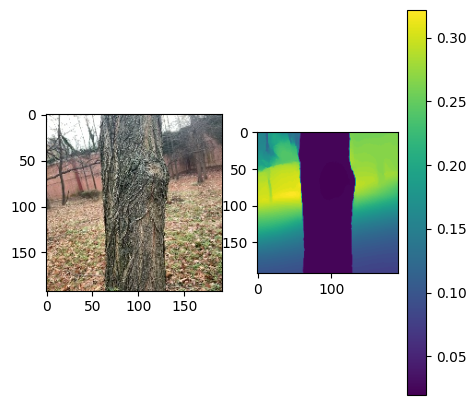

DBH: 21.01 cm


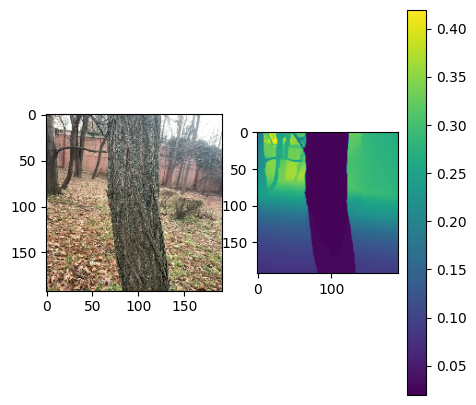

DBH: 29.13 cm


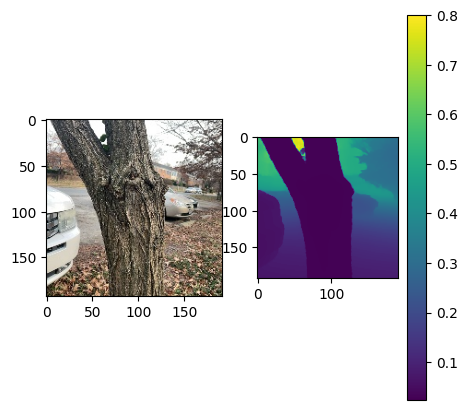

DBH: 21.96 cm


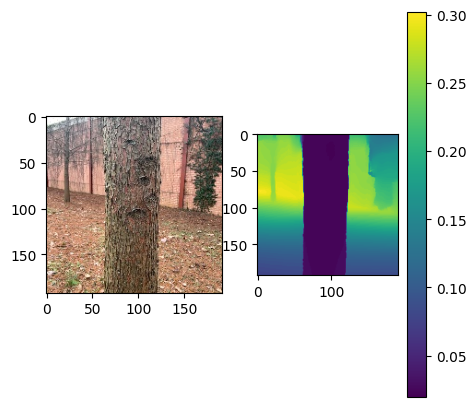

DBH: 18.46 cm


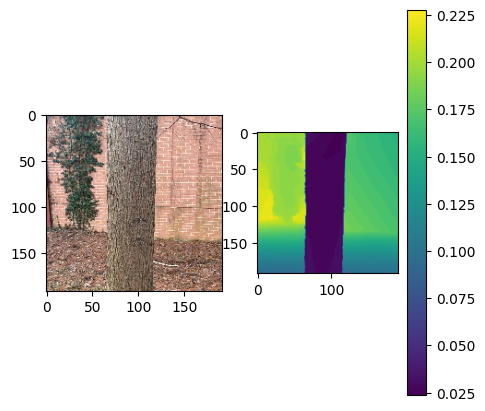

DBH: 26.74 cm


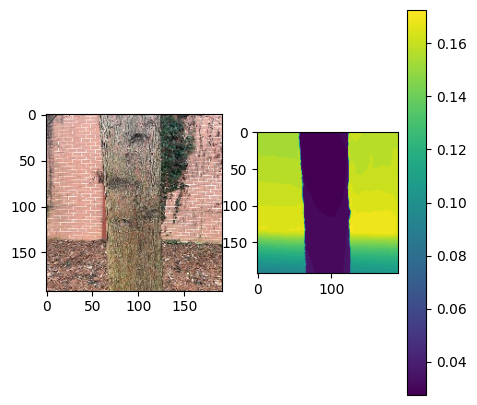

DBH: 21.33 cm


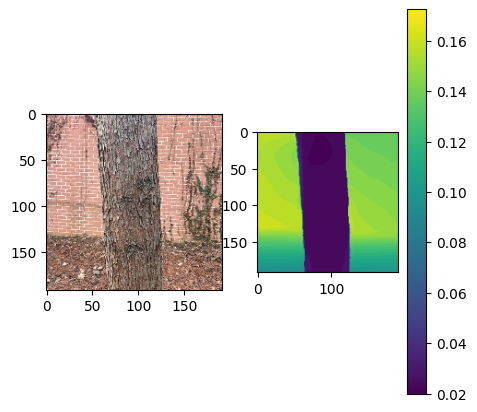

DBH: 21.33 cm


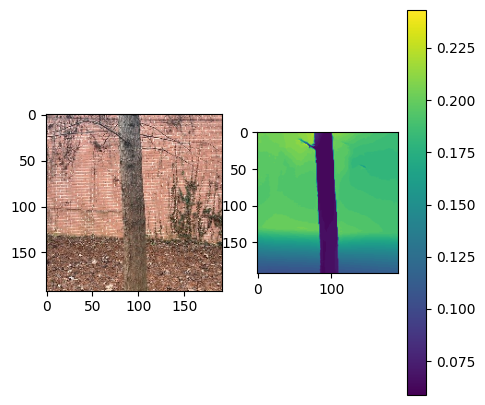

DBH: 21.01 cm


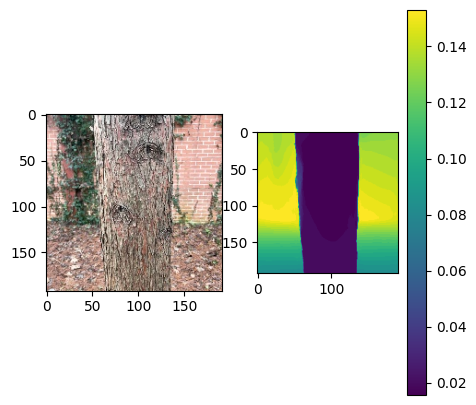

DBH: 20.05 cm


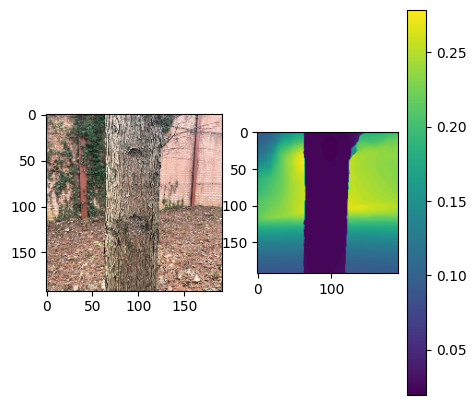

DBH: 40.11 cm


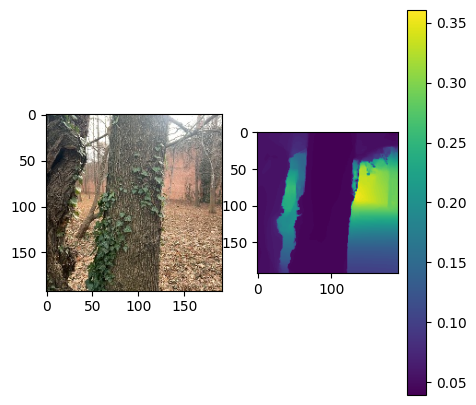

DBH: 28.65 cm


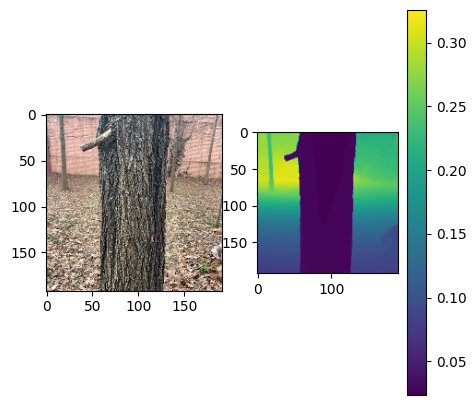

DBH: 36.29 cm


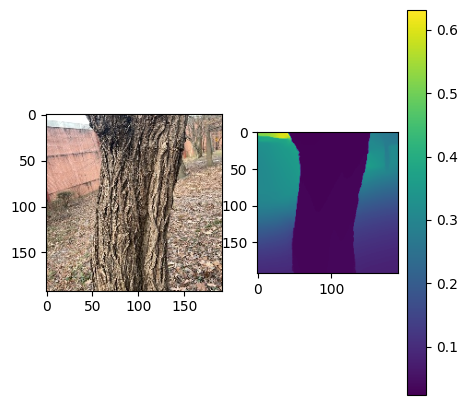

DBH: 34.38 cm


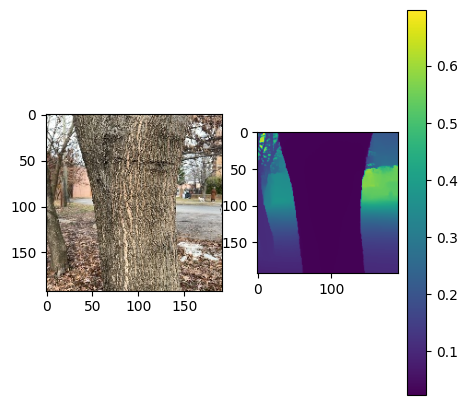

DBH: 38.52 cm


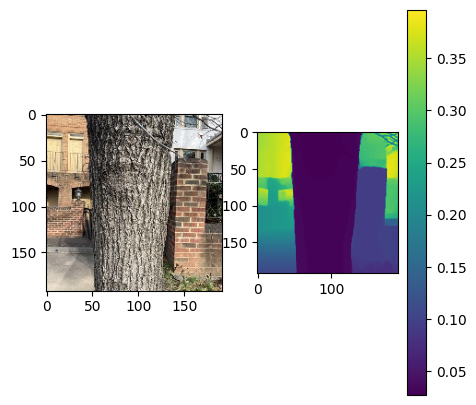

DBH: 46.79 cm


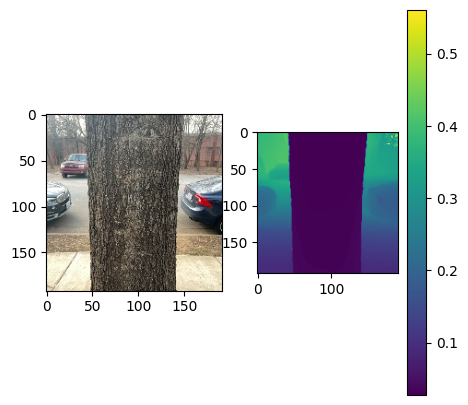

DBH: 42.02 cm


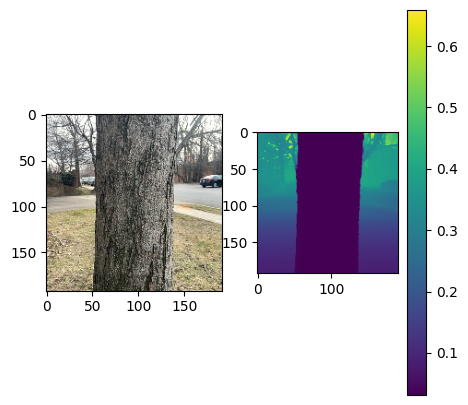

DBH: 39.47 cm


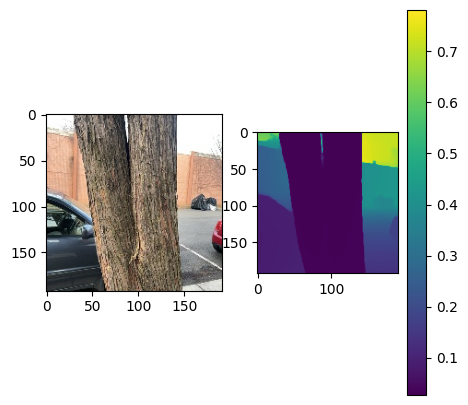

DBH: 55.7 cm


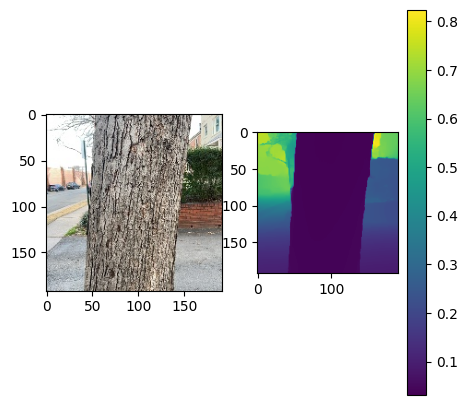

DBH: 74.48 cm


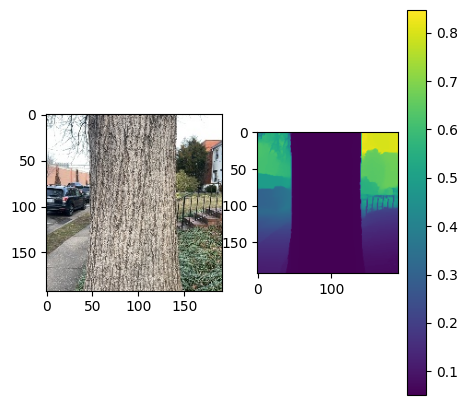

DBH: 74.48 cm


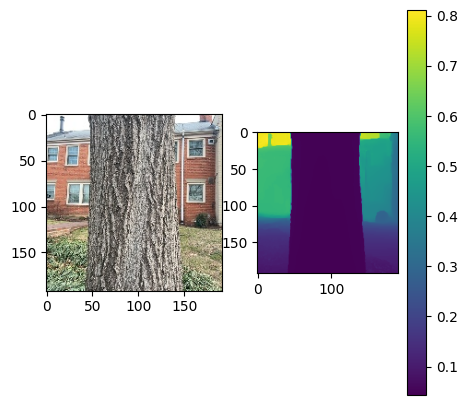

DBH: 85.63 cm


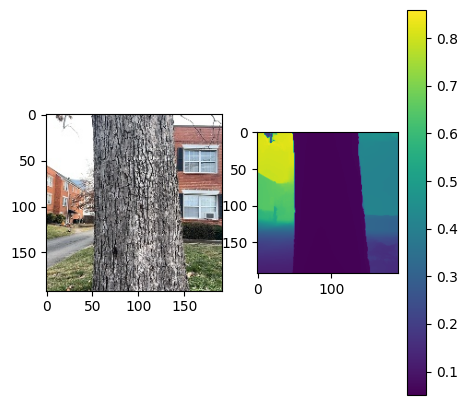

DBH: 85.63 cm


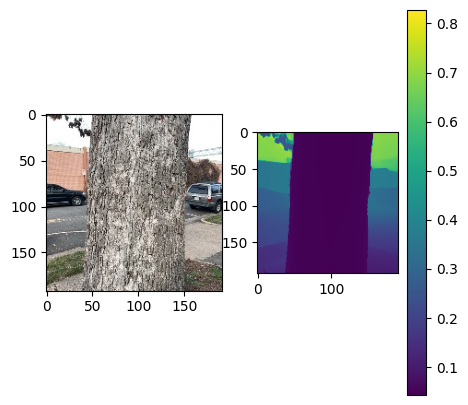

DBH: 80.85 cm


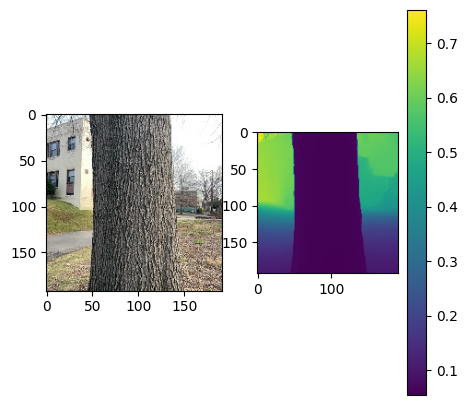

DBH: 80.85 cm


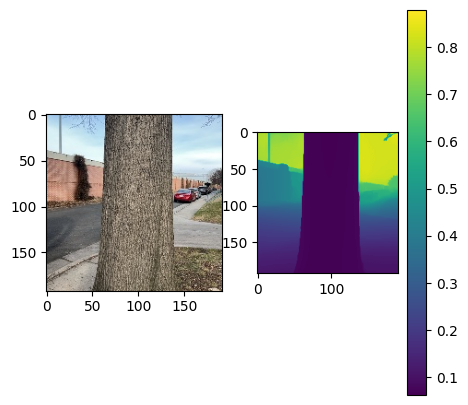

DBH: 80.85 cm


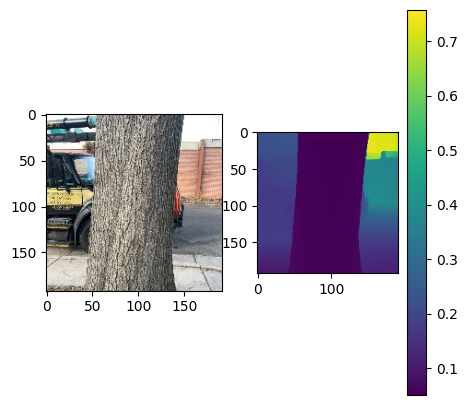

DBH: 59.84 cm


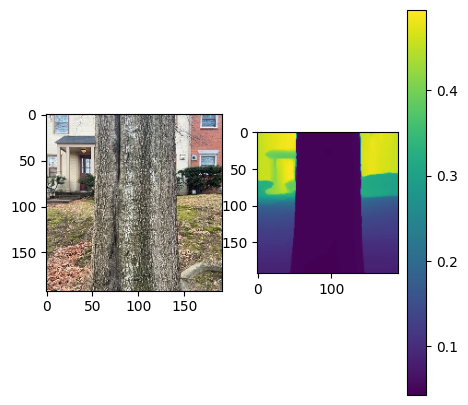

DBH: 68.75 cm


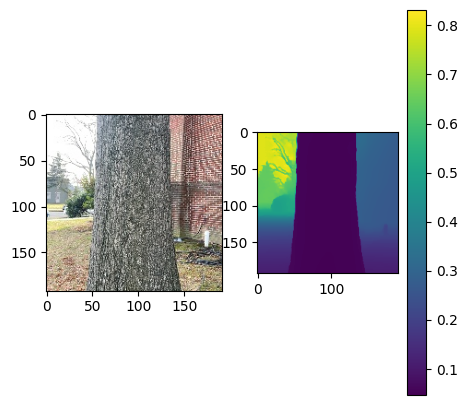

DBH: 68.75 cm


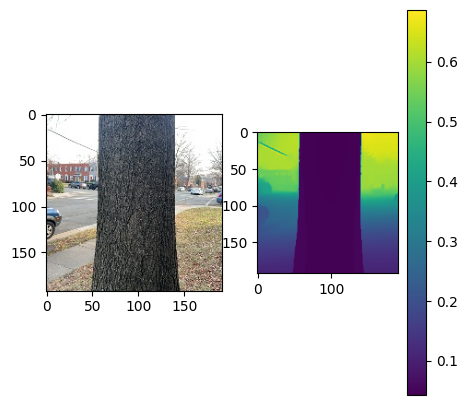

DBH: 93.9 cm


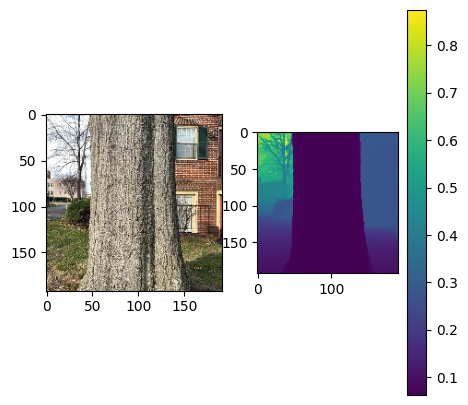

DBH: 93.9 cm


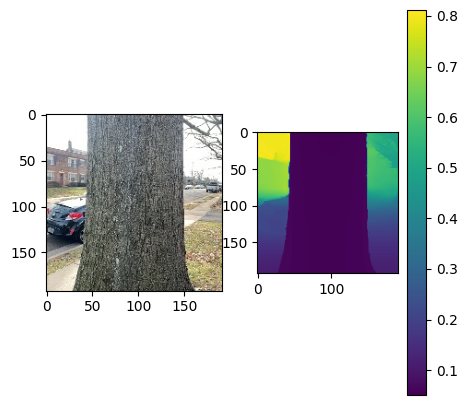

DBH: 48.06 cm


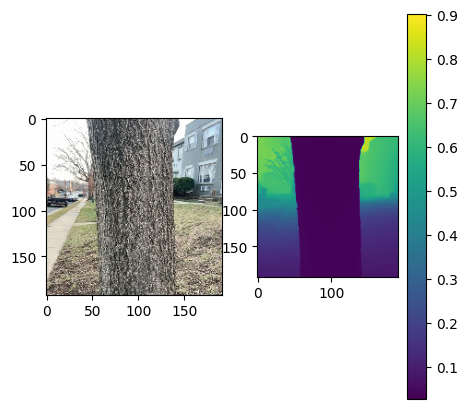

DBH: 104.41 cm


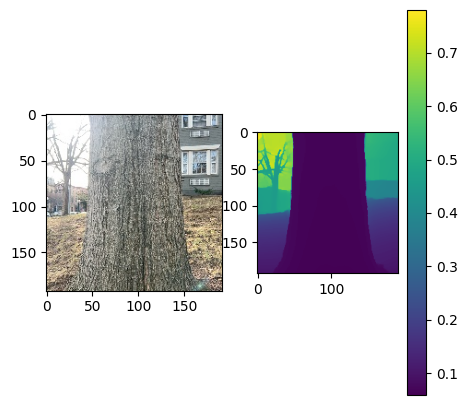

DBH: 70.03 cm


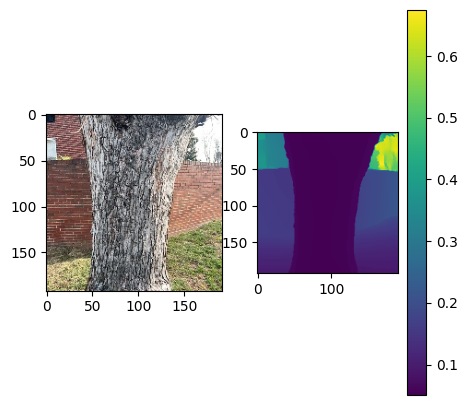

DBH: 70.03 cm


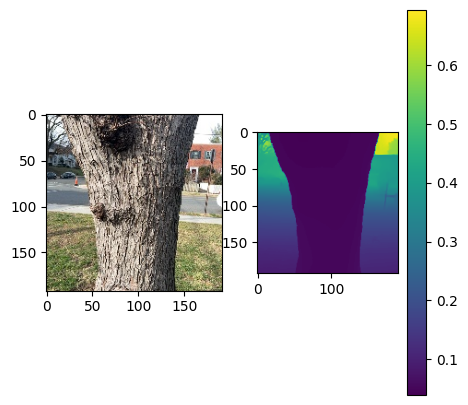

DBH: 102.18 cm


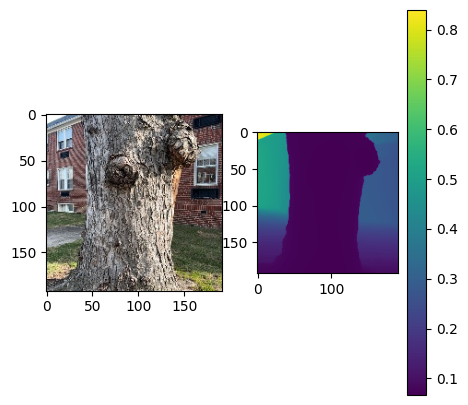

DBH: 102.18 cm


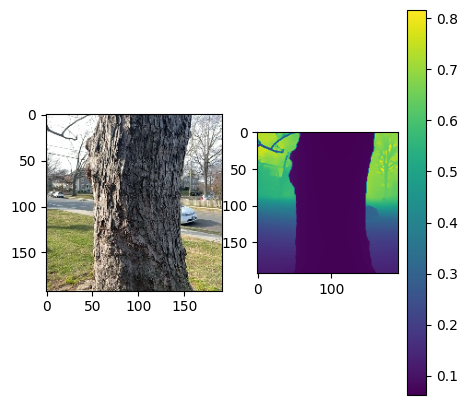

DBH: 85.94 cm


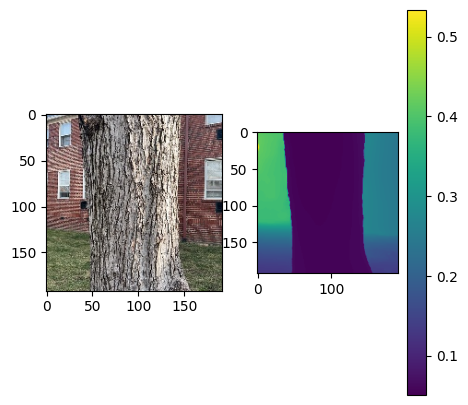

DBH: 85.94 cm


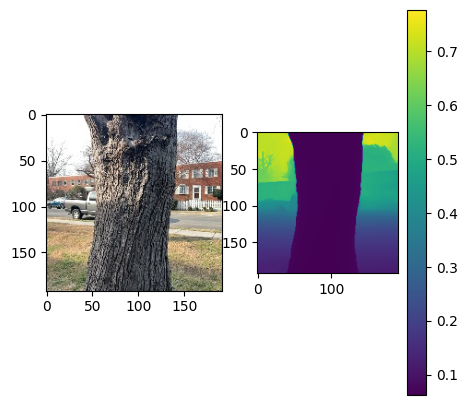

DBH: 78.62 cm


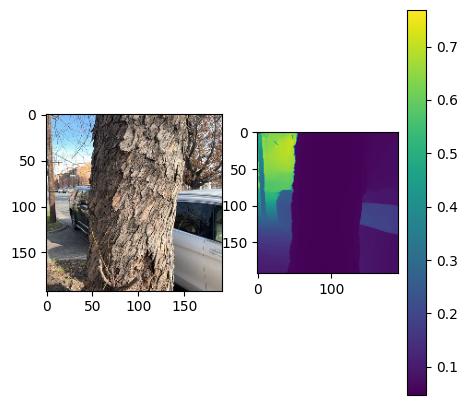

DBH: 102.81 cm


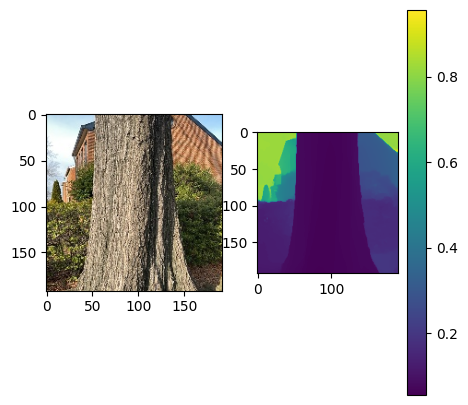

DBH: 102.81 cm


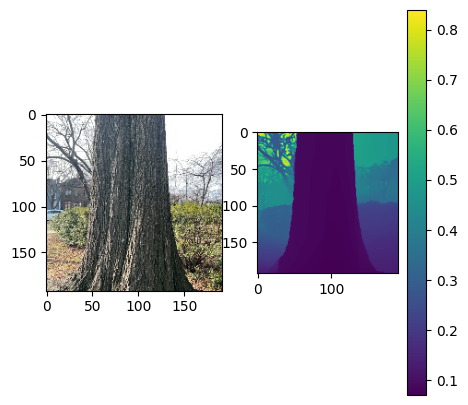

DBH: 81.81 cm


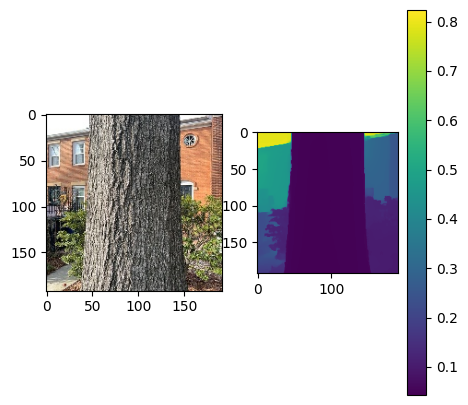

DBH: 81.81 cm


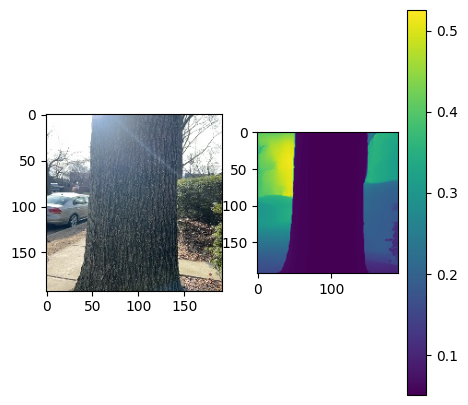

DBH: 75.76 cm


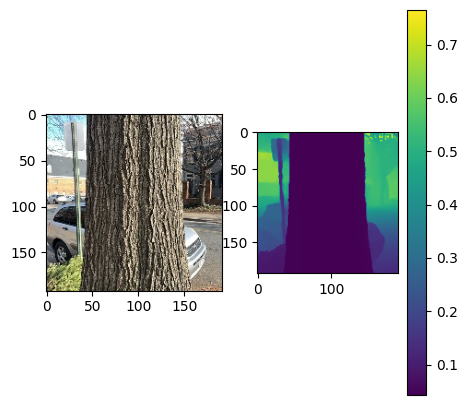

DBH: 42.97 cm


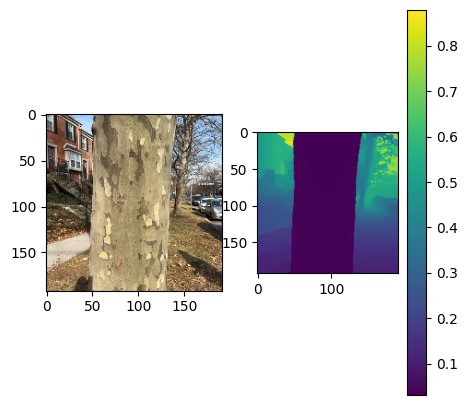

DBH: 43.93 cm


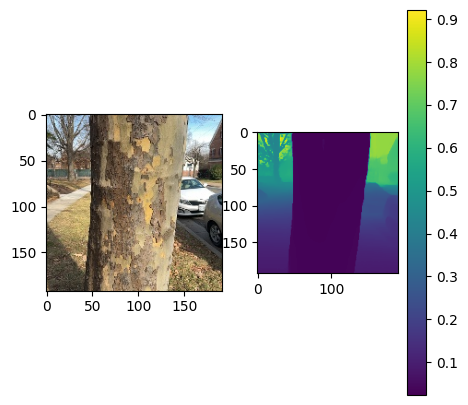

DBH: 66.85 cm


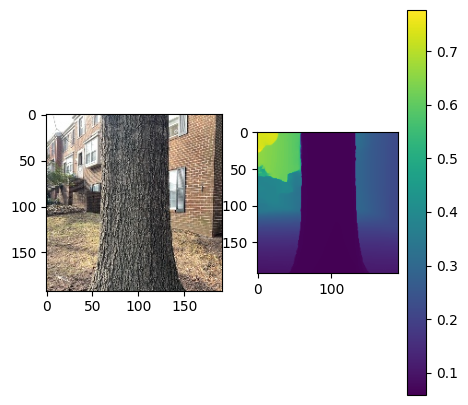

DBH: 66.85 cm


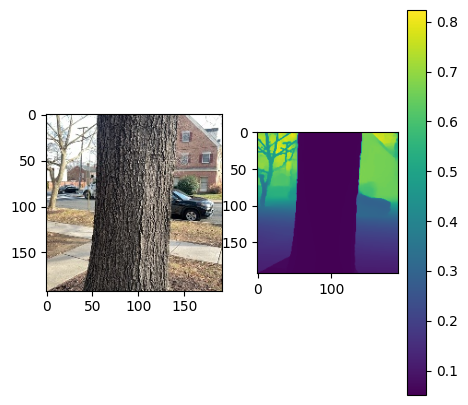

DBH: 80.85 cm


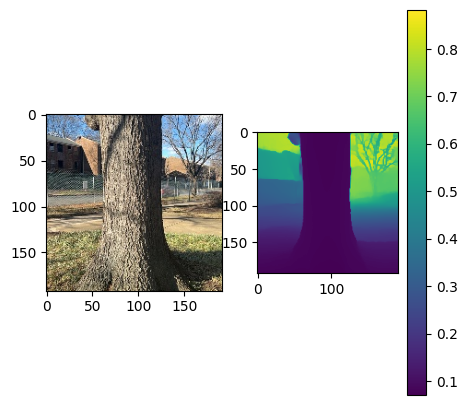

DBH: 80.85 cm


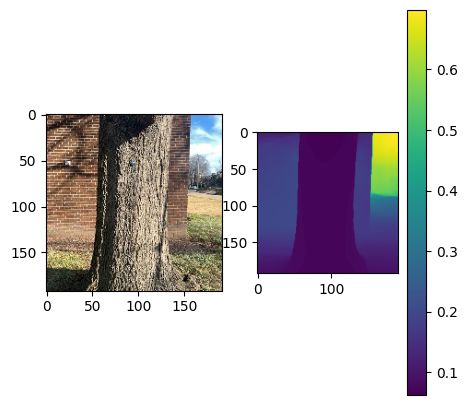

DBH: 80.85 cm


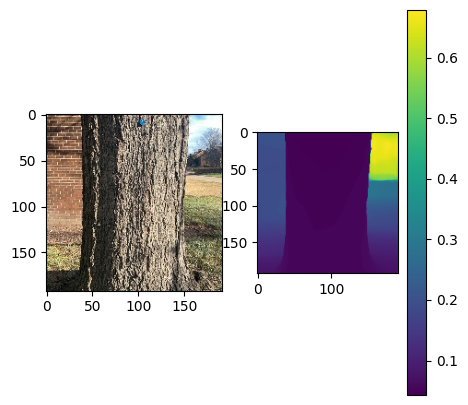

DBH: 80.85 cm


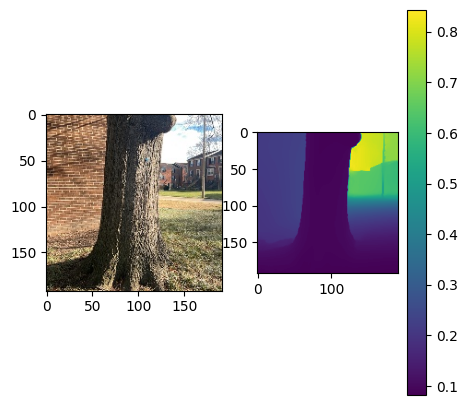

DBH: 22.28 cm


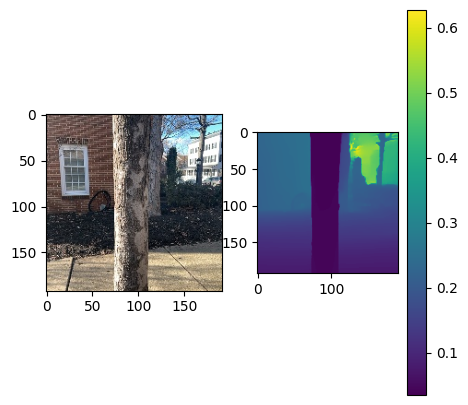

DBH: 18.46 cm


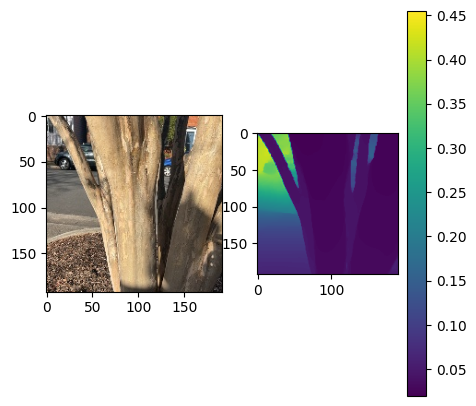

In [31]:
for i, sample in enumerate(ds_test):
    print(f'DBH: {round(float(sample.DBH.numpy()[0]), 2)} cm')
    plt.figure(figsize=(5,5))
    plt.subplot(1,2,1)
    plt.imshow(sample.images)
    plt.subplot(1,2,2)
    plt.imshow(sample.depth_maps.numpy()/255)
    plt.colorbar()
    plt.show()
    
    # if i == 2:
    #     break

In [32]:
DBH_list_test = []
for i, sample in enumerate(ds_test):
    DBH_list_test.append(sample.DBH.numpy()[0])
print(len(DBH_list_test))

164


In [33]:
DBH_list_test[0:10]

[0.0,
 9.549296,
 9.549296,
 9.549296,
 12.414085,
 12.414085,
 12.414085,
 14.642255,
 14.642255,
 14.642255]

In [34]:
DBH_df = pd.DataFrame({'DBH': np.array(DBH_list_test)})
DBH_df

,DBH
0,0.000000
1,9.549296
2,9.549296
3,9.549296
4,12.414085
...,...
159,80.850708
160,80.850708
161,80.850708
162,22.281693


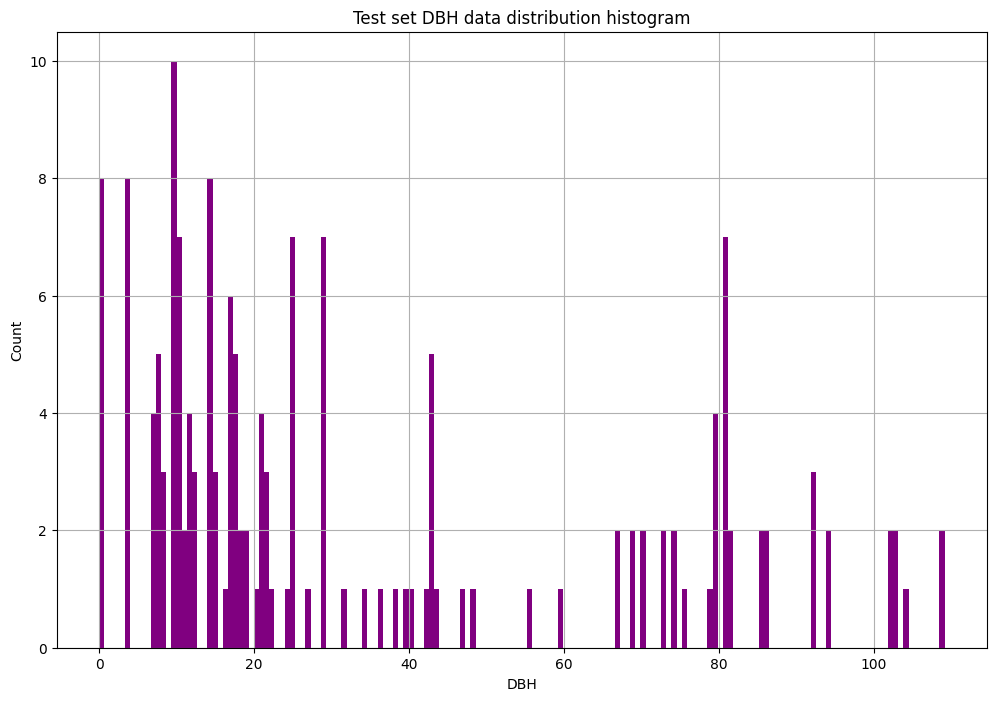

In [35]:
DBH_df.hist(figsize=[12, 8], bins=len(DBH_list_test), color='purple')
plt.title('Test set DBH data distribution histogram')
plt.xlabel('DBH')
plt.ylabel('Count')
plt.savefig(f"test_set_data_repartition_hist.png", dpi=500)

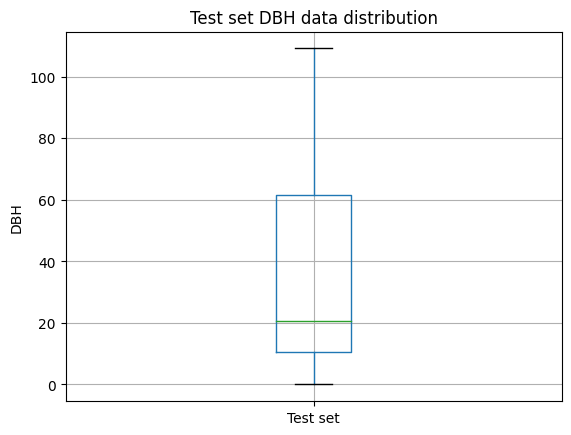

In [40]:
DBH_df_test = pd.DataFrame({'Test set': np.array(DBH_list_test)})
boxplot = DBH_df_test.boxplot(column=['Test set'])  
plt.title('Test set DBH data distribution')
plt.ylabel('DBH')
plt.savefig(f"test_set_data_repartition_boxplot.png", dpi=1000)

In [37]:
np.max(np.array(DBH_list_test))

109.18029

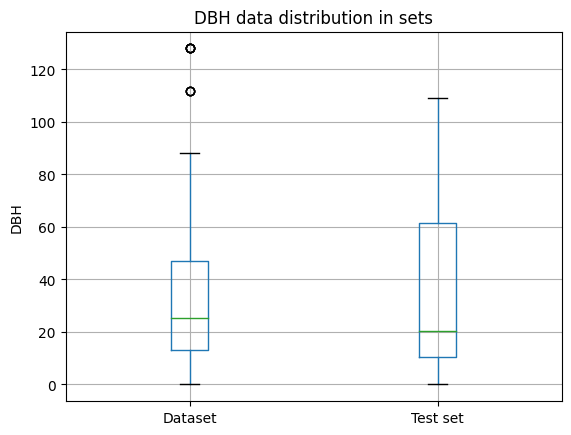

In [46]:
# df = pd.DataFrame({'price':np.random.uniform(0,100,100), 'urban':np.repeat(0,100)})
# df1 = pd.DataFrame({'price':np.random.uniform(0,100,100), 'urban':np.repeat(1,100)})

pd.concat([DBH_df_dataset,DBH_df_test]).boxplot()
plt.title('DBH data distribution in sets')
plt.ylabel('DBH')
plt.savefig(f"data_distribution.png", dpi=1000)

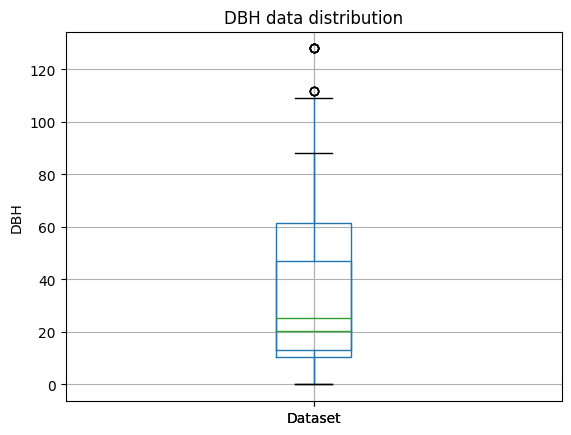

In [42]:
boxplot = DBH_df_test.boxplot(column=['Test set'])  
boxplot = DBH_df_dataset.boxplot(column=['Dataset'])  
plt.title('DBH data distribution')
plt.ylabel('DBH')
plt.savefig(f"test_set_data_repartition_boxplot.png", dpi=1000)

In [16]:
def to_model_fit(item):
    x = item['depth_maps'] 
    y = item['DBH']
    return (x, y)

In [17]:
BATCH_SIZE = 12
ds_tf_test = ds_test.tensorflow()
ds_tf_test = ds_tf_test.map(lambda x: to_model_fit(x))
test_ds = ds_tf_test.batch(BATCH_SIZE)


2023-01-17 11:45:33.220978: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [ ]:
model = load_model('trained-model.h5')

In [ ]:
predictions = model.predict(test_ds)
predictions.shape

In [ ]:
predictions[predictions<0] = 0  # replace negative results with 0 

In [ ]:
y_true_test = []
for img, dbh in test_ds:
    for b in range(dbh.shape[0]):
        y_true_test.append(dbh[b].numpy()[0])
        

In [ ]:
from sklearn.metrics import mean_squared_error
from math import sqrt
rmse = round(sqrt(mean_squared_error(predictions, y_true_test)),2)
rmse

In [ ]:
list_error = []
for img, dbh in test_ds:
    for b in range(0, dbh.shape[0]):
        print(f'Real DBH: {dbh[b].numpy()}, predicted DBH: {predictions[b]}')
        list_error.append(abs(dbh[b].numpy()-predictions[b]))
        plt.figure(figsize=(2,2))
        plt.imshow(img[b])
        plt.show()


In [ ]:
print(f'Mean error is: {np.mean(list_error)} cm')


In [ ]:
mse_test, root_mean_squared_error_test, mae_test = model.evaluate(test_ds)


In [ ]:
print(f'RMSE DBH Regression and DBH Tape: {round(sqrt(mean_squared_error(np.array(y_true_test), np.array(predictions)[:,0])),2)} cm')

In [ ]:
print(f'RMSE DBH Regression and DBH Tape: {round(sqrt(mean_squared_error(np.array(y_true_test), np.array(predictions)[:,0])),2)} cm')

In [ ]:
import pandas as pd
df_DBH = pd.DataFrame({'y_true_test': np.array(y_true_test),
                      'predictions': np.array(predictions)[:,0]})

In [ ]:
max_value = np.max([np.max(y_true_test), np.max(predictions)])
plt.figure(dpi=1000, figsize=(9,6))
ax = df_DBH.plot(x = 'y_true_test',y='predictions', kind = 'scatter', figsize=(9,6), color='blue')
line = lines.Line2D([0,np.max([np.max(y_true_test), np.max(predictions)])], [0,np.max([np.max(y_true_test), np.max(predictions)])],lw=2, color='green', axes=ax)
ax.add_line(line)
plt.title('DBH measured with tape versus DBH estimated with CNN')
plt.ylabel('DBH estimated with CNN (cm)')
plt.xlabel('DBH measured with tape (cm)')
plt.legend(['DBH estimated with CNN', 'Linear Function'], loc='center left', bbox_to_anchor=(1.0, 0.5))
plt.tight_layout()
# plt.savefig(f"{model_name}/{model_name}_{datetime.now().month}_{datetime.now().day}_{datetime.now().year}.png", dpi=100)
# wandb.log({"Scatter plot": wandb.Image(f"{model_name}/{model_name}_{datetime.now().month}_{datetime.now().day}_{datetime.now().year}.png")})
plt.show()


In [ ]:
r2 = metrics.r2_score(y_true_test, predictions)
r2

## CoreML conversion

In [ ]:
# Tensorflow to CoreMl Conversion
import coremltools as ct
# image_input = ct.ImageType(color_layout=ct.colorlayout.RGB, scale=1/255.0)
image_input = ct.ImageType(color_layout=ct.colorlayout.GRAYSCALE, scale=1/255.0)

# Set input as ImageType so CoreML can automatically resize it using Vision framework
coreml_model = ct.convert(model, inputs=[image_input])
print("Tensorflow model converted to CoreML.")


# Save CoreML Model
current_date = datetime.now().strftime('%Y-%m-%d')
file_name = "tree_regression_depthmap_" + current_date + ".mlmodel"
local_file_path = os.path.join(model_name, file_name)
coreml_model.save(local_file_path)

print("Core ML model named {} saved in {}.".format(file_name, local_file_path))

# TFlite

In [ ]:
converter = tf.lite.TFLiteConverter.from_keras_model(model)
tflite_model = converter.convert()
open(f"{checkpoint_folder}/model.tflite", "wb").write(tflite_model)